In [1]:
#location of the training data 
data_location =  'data/input/archive'

import numpy as np
from tqdm import tqdm
import torch
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T
import torch.nn as nn
import torch.optim as optim
import matplotlib.pyplot as plt

from data_loader import FlickrDataset,get_data_loader, show_image

# device = torch.device('cpu') 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
device

device(type='cuda', index=0)

### 1. Data Loader

In [2]:
BATCH_SIZE = 32
NUM_WORKER = 4

#defining the transform to be applied
transforms = T.Compose([
    T.Resize(226),                     
    T.RandomCrop(224),                 
    T.ToTensor(),                               
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])

#testing the dataset class
dataset =  FlickrDataset(
    root_dir = data_location+"/Images",
    captions_file = data_location+"/captions.txt",
    transform=transforms
)

#writing the dataloader
data_loader = get_data_loader(
    dataset=dataset,
    batch_size=BATCH_SIZE,
    num_workers=NUM_WORKER,
    shuffle=True,
    # batch_first=False
)

#vocab_size
vocab_size = len(dataset.vocab)
print(f"vocab size: {vocab_size}")

vocab size: 2994


### 2. Model and optimizer

In [3]:
from model import EncoderDecoder

#Hyperparams
embed_size=300
attention_dim=256
encoder_dim=2048
decoder_dim=512
learning_rate = 3e-4

#init model
model = EncoderDecoder(
    embed_size=300,
    vocab_size = len(dataset.vocab),
    attention_dim=256,
    encoder_dim=2048,
    decoder_dim=512
).to(device)

criterion = nn.CrossEntropyLoss(ignore_index=dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

#helper function to save the model
def save_model(model,num_epochs):
    model_state = {
        'num_epochs':num_epochs,
        'embed_size':embed_size,
        'vocab_size':len(dataset.vocab),
        'attention_dim':attention_dim,
        'encoder_dim':encoder_dim,
        'decoder_dim':decoder_dim,
        'state_dict':model.state_dict()
    }

    torch.save(model_state,'attention_model_state.pth')

  8%|▊         | 99/1265 [00:45<08:27,  2.30it/s]

Epoch: 1 loss: 4.30584


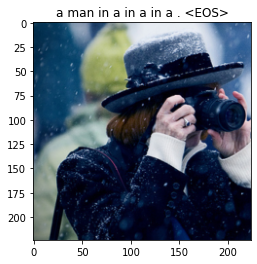

 16%|█▌        | 199/1265 [01:31<07:29,  2.37it/s]

Epoch: 1 loss: 3.81371


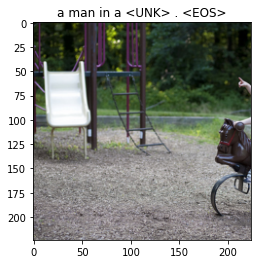

 24%|██▎       | 299/1265 [02:18<07:16,  2.21it/s]

Epoch: 1 loss: 3.97295


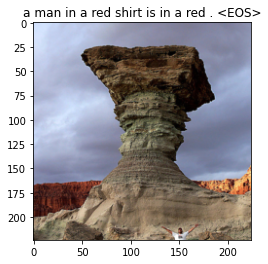

 32%|███▏      | 399/1265 [03:05<06:47,  2.13it/s]

Epoch: 1 loss: 3.55766


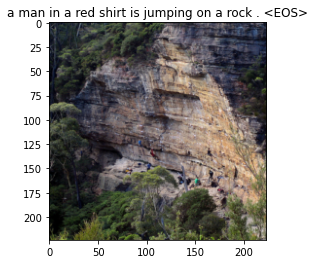

 39%|███▉      | 499/1265 [03:52<06:10,  2.07it/s]

Epoch: 1 loss: 3.72328


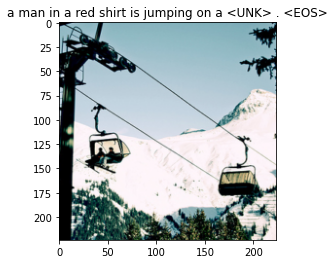

 47%|████▋     | 599/1265 [04:38<05:22,  2.06it/s]

Epoch: 1 loss: 3.58256


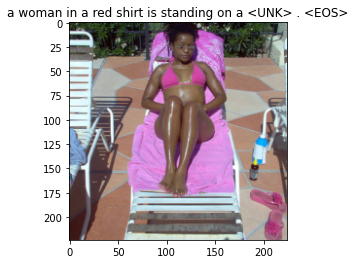

 55%|█████▌    | 699/1265 [05:24<04:38,  2.03it/s]

Epoch: 1 loss: 3.43552


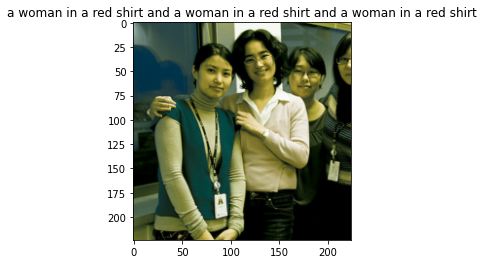

 63%|██████▎   | 799/1265 [06:10<03:31,  2.21it/s]

Epoch: 1 loss: 3.55365


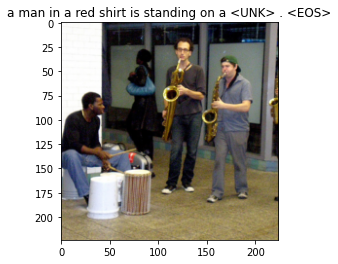

 71%|███████   | 899/1265 [06:56<02:42,  2.26it/s]

Epoch: 1 loss: 3.48498


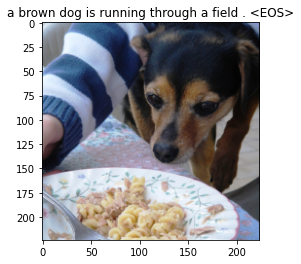

 79%|███████▉  | 999/1265 [07:43<02:12,  2.01it/s]

Epoch: 1 loss: 3.57095


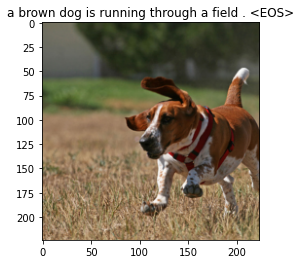

 87%|████████▋ | 1099/1265 [08:29<01:12,  2.28it/s]

Epoch: 1 loss: 3.23915


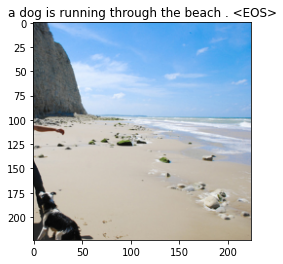

 95%|█████████▍| 1199/1265 [09:15<00:28,  2.28it/s]

Epoch: 1 loss: 3.29617


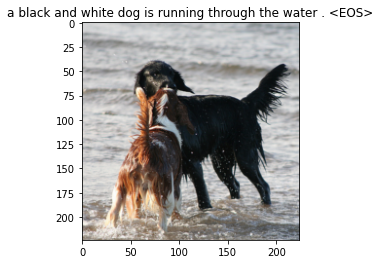

  8%|▊         | 99/1265 [00:45<08:22,  2.32it/s]

Epoch: 2 loss: 3.18303


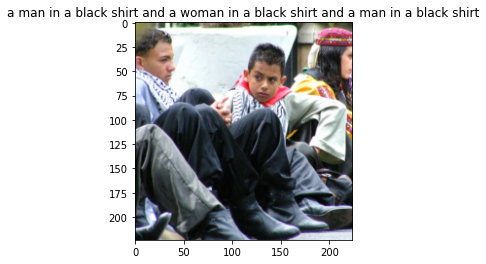

 16%|█▌        | 199/1265 [01:31<07:49,  2.27it/s]

Epoch: 2 loss: 2.78690


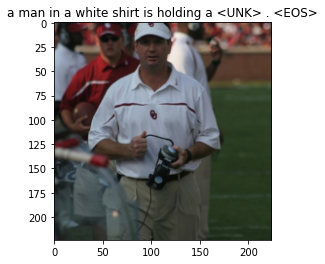

 24%|██▎       | 299/1265 [02:17<07:09,  2.25it/s]

Epoch: 2 loss: 2.77750


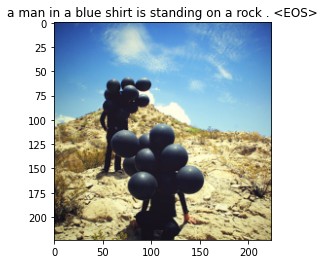

 32%|███▏      | 399/1265 [03:03<06:16,  2.30it/s]

Epoch: 2 loss: 3.28521


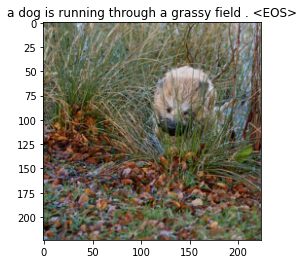

 39%|███▉      | 499/1265 [03:50<05:42,  2.24it/s]

Epoch: 2 loss: 3.03597


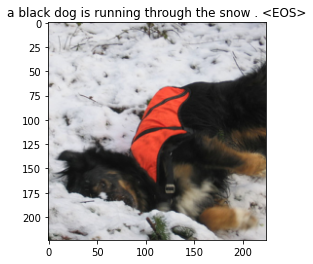

 47%|████▋     | 599/1265 [04:36<05:16,  2.11it/s]

Epoch: 2 loss: 3.06719


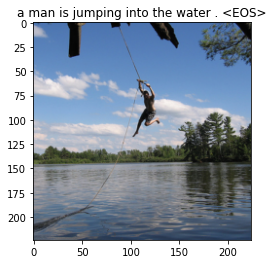

 55%|█████▌    | 699/1265 [05:22<04:27,  2.12it/s]

Epoch: 2 loss: 2.91349


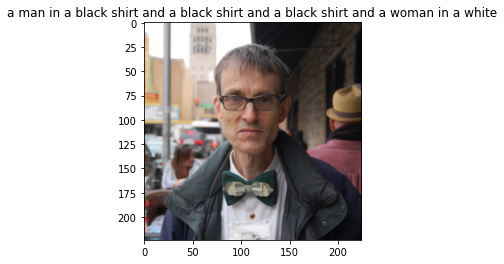

 63%|██████▎   | 799/1265 [06:09<03:51,  2.01it/s]

Epoch: 2 loss: 2.96009


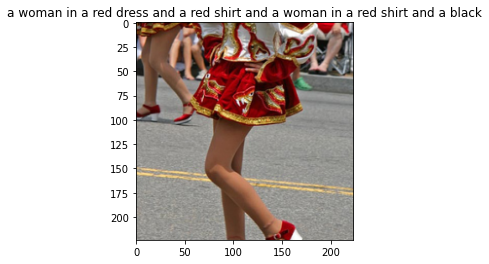

 71%|███████   | 899/1265 [06:55<02:42,  2.25it/s]

Epoch: 2 loss: 2.86570


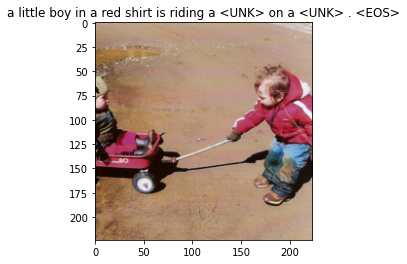

 79%|███████▉  | 999/1265 [07:41<01:57,  2.26it/s]

Epoch: 2 loss: 3.18665


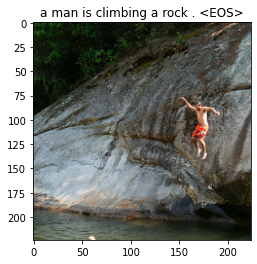

 87%|████████▋ | 1099/1265 [08:27<01:12,  2.29it/s]

Epoch: 2 loss: 2.90973


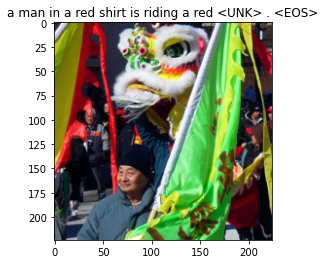

 95%|█████████▍| 1199/1265 [09:13<00:28,  2.28it/s]

Epoch: 2 loss: 2.76945


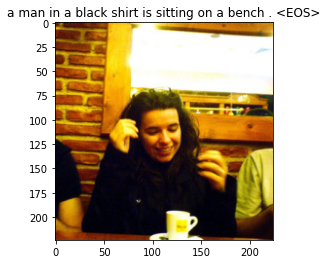

  8%|▊         | 99/1265 [00:45<09:12,  2.11it/s]

Epoch: 3 loss: 2.94429


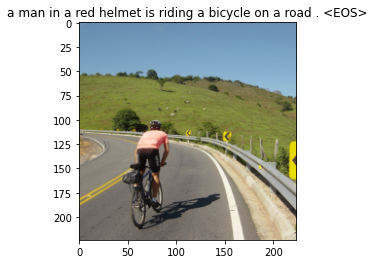

 16%|█▌        | 199/1265 [01:30<07:52,  2.26it/s]

Epoch: 3 loss: 2.81824


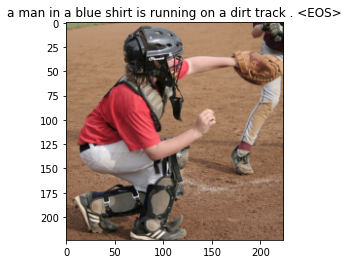

 24%|██▎       | 299/1265 [02:16<07:01,  2.29it/s]

Epoch: 3 loss: 3.04780


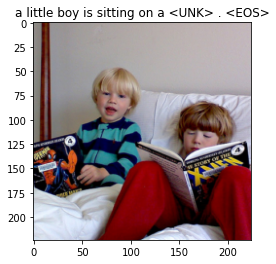

 32%|███▏      | 399/1265 [03:02<06:29,  2.22it/s]

Epoch: 3 loss: 2.72564


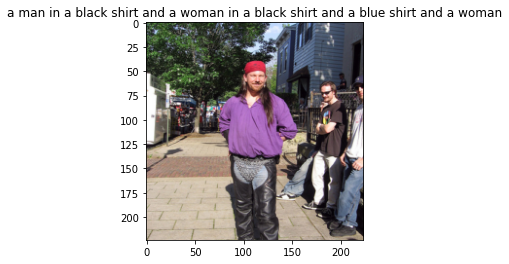

 39%|███▉      | 499/1265 [03:48<05:40,  2.25it/s]

Epoch: 3 loss: 2.97446


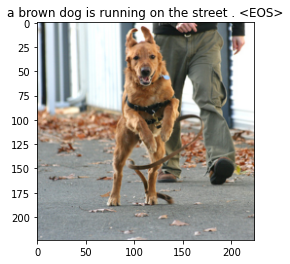

 47%|████▋     | 599/1265 [04:35<05:02,  2.20it/s]

Epoch: 3 loss: 2.83791


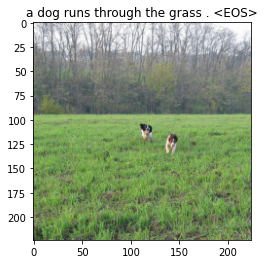

 55%|█████▌    | 699/1265 [05:21<04:04,  2.32it/s]

Epoch: 3 loss: 2.82337


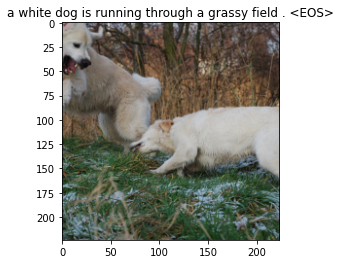

 63%|██████▎   | 799/1265 [06:08<03:27,  2.25it/s]

Epoch: 3 loss: 2.71760


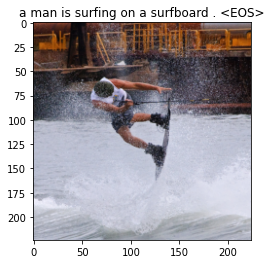

 71%|███████   | 899/1265 [06:54<02:53,  2.11it/s]

Epoch: 3 loss: 2.56306


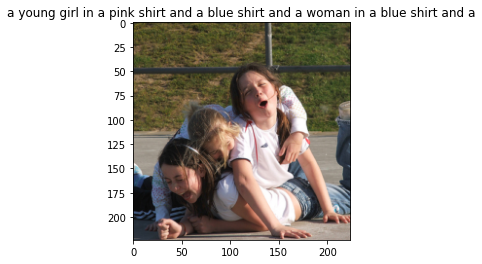

 79%|███████▉  | 999/1265 [07:41<01:58,  2.24it/s]

Epoch: 3 loss: 2.94424


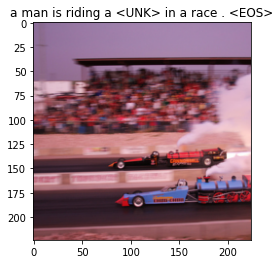

 87%|████████▋ | 1099/1265 [08:27<01:11,  2.31it/s]

Epoch: 3 loss: 2.63672


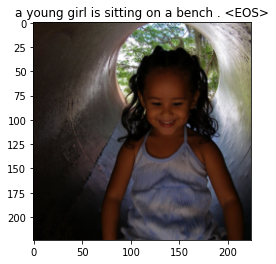

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.28it/s]

Epoch: 3 loss: 2.60514


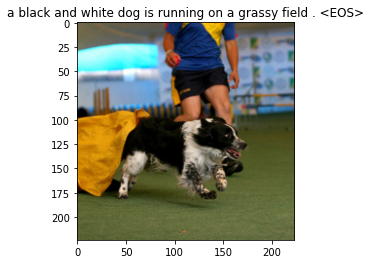

  8%|▊         | 99/1265 [00:45<08:26,  2.30it/s]

Epoch: 4 loss: 2.90134


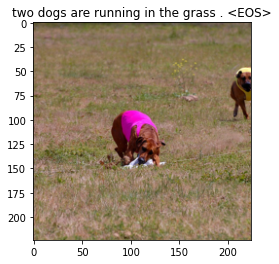

 16%|█▌        | 199/1265 [01:31<07:50,  2.27it/s]

Epoch: 4 loss: 2.39990


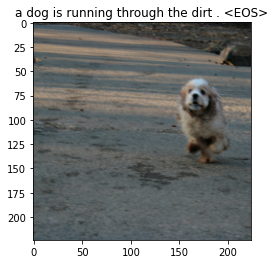

 24%|██▎       | 299/1265 [02:18<07:07,  2.26it/s]

Epoch: 4 loss: 2.77638


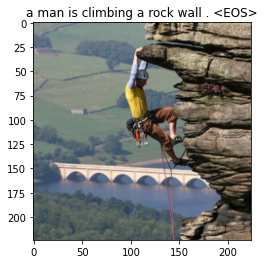

 32%|███▏      | 399/1265 [03:04<06:55,  2.08it/s]

Epoch: 4 loss: 2.58389


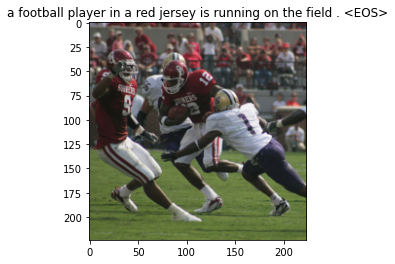

 39%|███▉      | 499/1265 [03:50<05:33,  2.30it/s]

Epoch: 4 loss: 2.42331


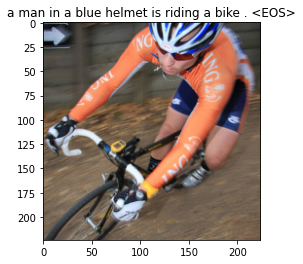

 47%|████▋     | 599/1265 [04:37<04:57,  2.24it/s]

Epoch: 4 loss: 2.68648


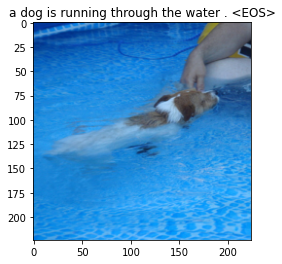

 55%|█████▌    | 699/1265 [05:23<04:28,  2.11it/s]

Epoch: 4 loss: 2.58884


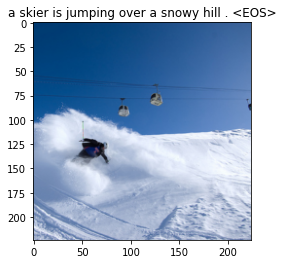

 63%|██████▎   | 799/1265 [06:09<03:21,  2.32it/s]

Epoch: 4 loss: 2.51969


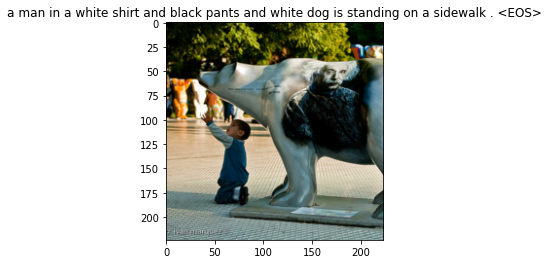

 71%|███████   | 899/1265 [06:56<02:46,  2.20it/s]

Epoch: 4 loss: 2.58059


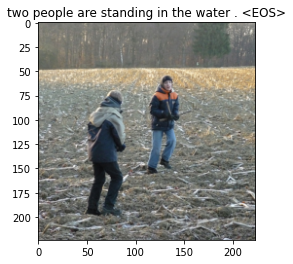

 79%|███████▉  | 999/1265 [07:42<01:55,  2.31it/s]

Epoch: 4 loss: 2.62449


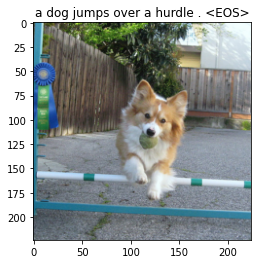

 87%|████████▋ | 1099/1265 [08:29<01:12,  2.29it/s]

Epoch: 4 loss: 2.61148


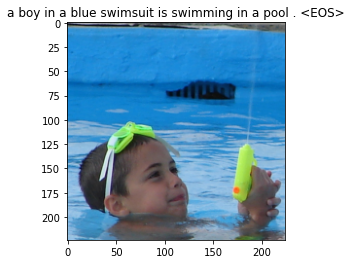

 95%|█████████▍| 1199/1265 [09:15<00:31,  2.08it/s]

Epoch: 4 loss: 2.80158


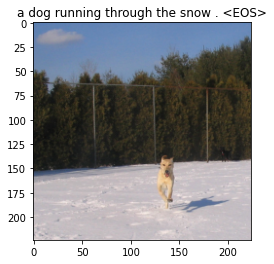

  8%|▊         | 99/1265 [00:45<09:32,  2.04it/s]

Epoch: 5 loss: 2.52682


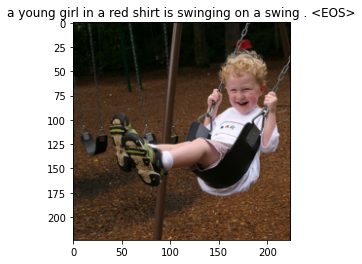

 16%|█▌        | 199/1265 [01:31<07:47,  2.28it/s]

Epoch: 5 loss: 2.71331


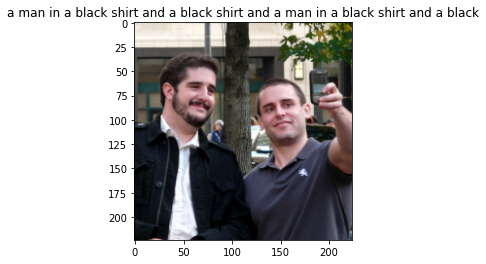

 24%|██▎       | 299/1265 [02:17<07:02,  2.29it/s]

Epoch: 5 loss: 2.47937


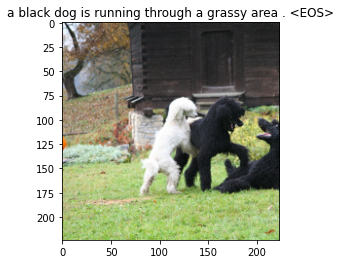

 32%|███▏      | 399/1265 [03:03<06:21,  2.27it/s]

Epoch: 5 loss: 2.42251


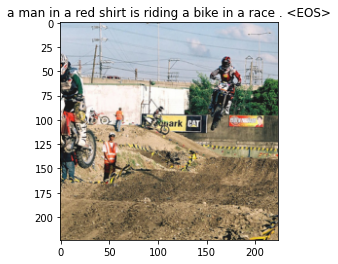

 39%|███▉      | 499/1265 [03:50<06:01,  2.12it/s]

Epoch: 5 loss: 2.74193


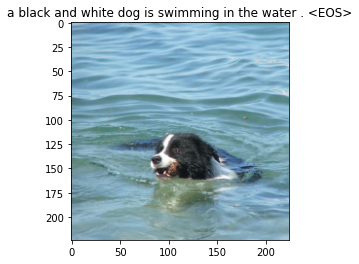

 47%|████▋     | 599/1265 [04:36<04:46,  2.32it/s]

Epoch: 5 loss: 2.69305


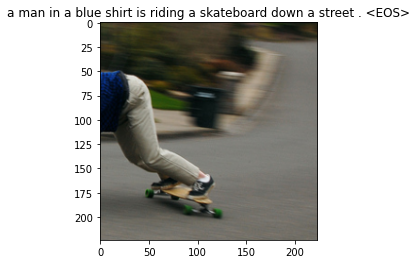

 55%|█████▌    | 699/1265 [05:22<04:06,  2.30it/s]

Epoch: 5 loss: 2.48937


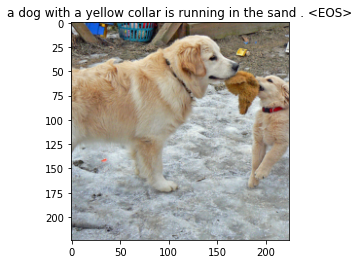

 63%|██████▎   | 799/1265 [06:09<03:27,  2.25it/s]

Epoch: 5 loss: 2.47955


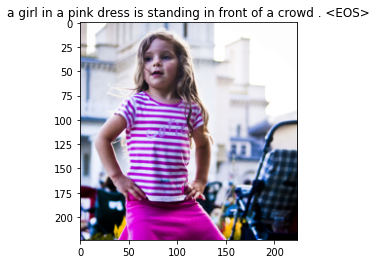

 71%|███████   | 899/1265 [06:55<02:40,  2.28it/s]

Epoch: 5 loss: 2.63748


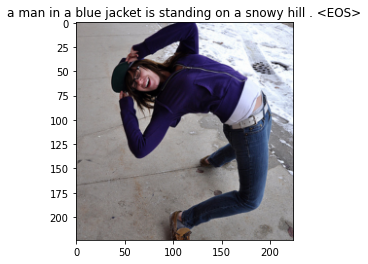

 79%|███████▉  | 999/1265 [07:42<02:12,  2.01it/s]

Epoch: 5 loss: 2.58078


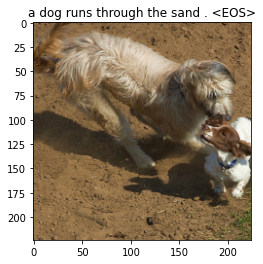

 87%|████████▋ | 1099/1265 [08:28<01:13,  2.26it/s]

Epoch: 5 loss: 2.48302


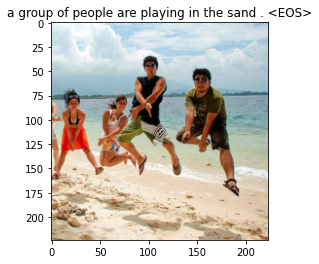

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.31it/s]

Epoch: 5 loss: 2.56732


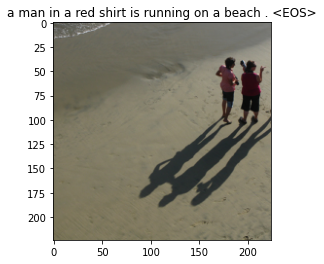

  8%|▊         | 99/1265 [00:45<08:23,  2.32it/s]

Epoch: 6 loss: 2.67302


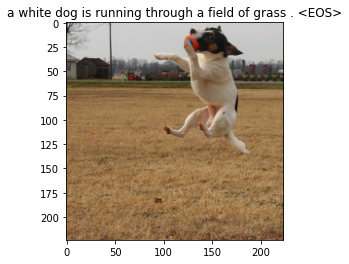

 16%|█▌        | 199/1265 [01:31<07:47,  2.28it/s]

Epoch: 6 loss: 2.45723


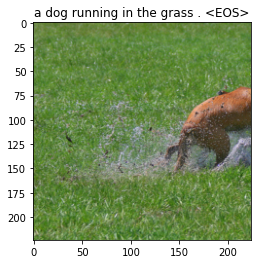

 24%|██▎       | 299/1265 [02:17<07:07,  2.26it/s]

Epoch: 6 loss: 2.54617


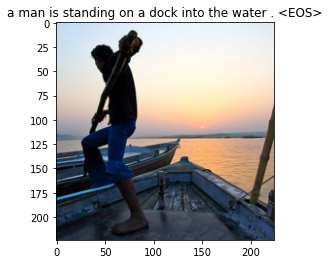

 32%|███▏      | 399/1265 [03:03<06:18,  2.29it/s]

Epoch: 6 loss: 2.80903


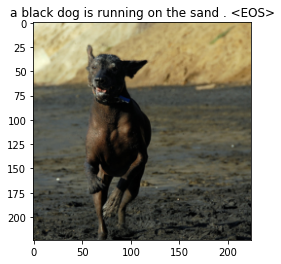

 39%|███▉      | 499/1265 [03:50<06:01,  2.12it/s]

Epoch: 6 loss: 2.54567


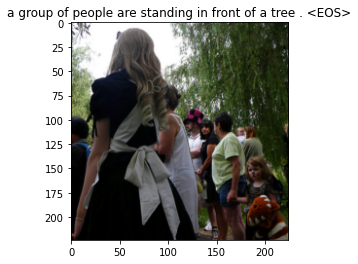

 47%|████▋     | 599/1265 [04:36<05:19,  2.08it/s]

Epoch: 6 loss: 2.40382


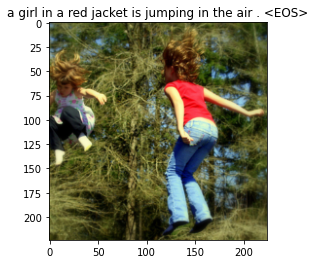

 55%|█████▌    | 699/1265 [05:23<04:31,  2.09it/s]

Epoch: 6 loss: 2.37801


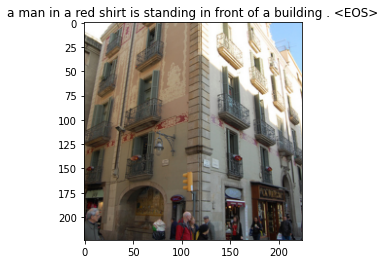

 63%|██████▎   | 799/1265 [06:09<03:24,  2.28it/s]

Epoch: 6 loss: 2.31887


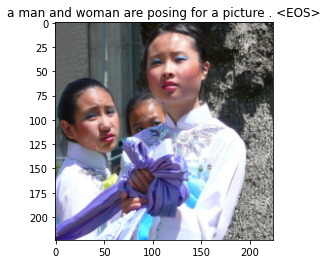

 71%|███████   | 899/1265 [06:55<02:38,  2.31it/s]

Epoch: 6 loss: 2.64645


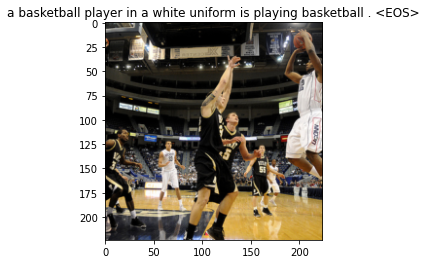

 79%|███████▉  | 999/1265 [07:42<01:58,  2.24it/s]

Epoch: 6 loss: 2.74189


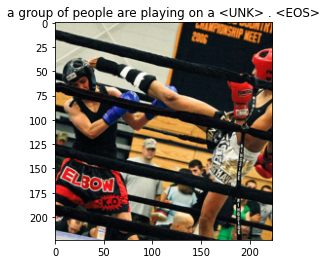

 87%|████████▋ | 1099/1265 [08:28<01:19,  2.10it/s]

Epoch: 6 loss: 2.41940


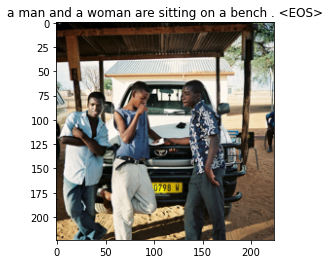

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.29it/s]

Epoch: 6 loss: 2.42307


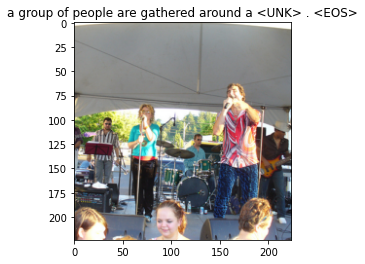

  8%|▊         | 99/1265 [00:45<08:39,  2.24it/s]

Epoch: 7 loss: 2.27808


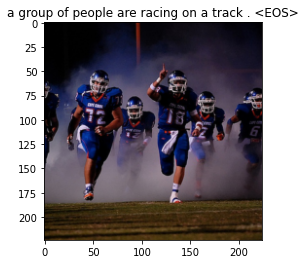

 16%|█▌        | 199/1265 [01:31<08:30,  2.09it/s]

Epoch: 7 loss: 2.42698


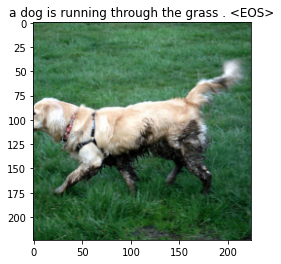

 24%|██▎       | 299/1265 [02:17<07:03,  2.28it/s]

Epoch: 7 loss: 2.37464


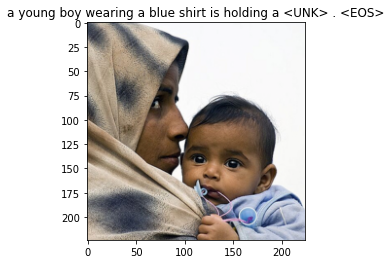

 32%|███▏      | 399/1265 [03:03<06:56,  2.08it/s]

Epoch: 7 loss: 2.19175


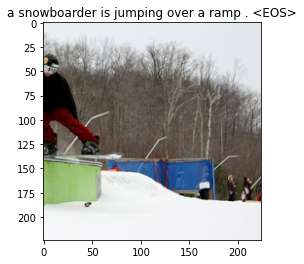

 39%|███▉      | 499/1265 [03:50<05:34,  2.29it/s]

Epoch: 7 loss: 2.26670


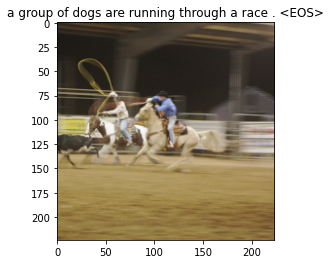

 47%|████▋     | 599/1265 [04:36<04:43,  2.35it/s]

Epoch: 7 loss: 2.36179


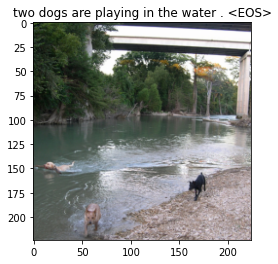

 55%|█████▌    | 699/1265 [05:22<04:11,  2.25it/s]

Epoch: 7 loss: 2.28656


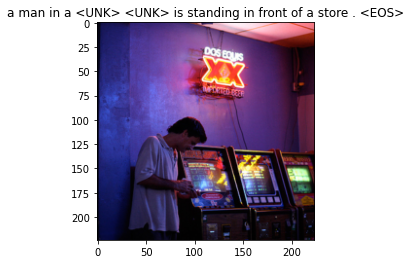

 63%|██████▎   | 799/1265 [06:09<03:25,  2.27it/s]

Epoch: 7 loss: 2.41509


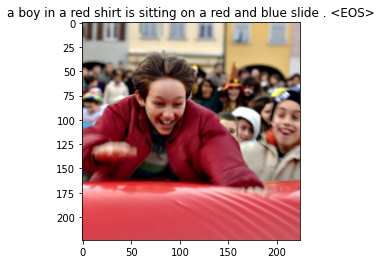

 71%|███████   | 899/1265 [06:55<02:40,  2.27it/s]

Epoch: 7 loss: 2.34244


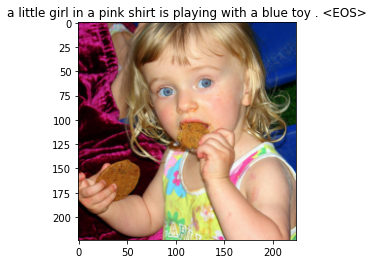

 79%|███████▉  | 999/1265 [07:42<02:04,  2.14it/s]

Epoch: 7 loss: 2.51191


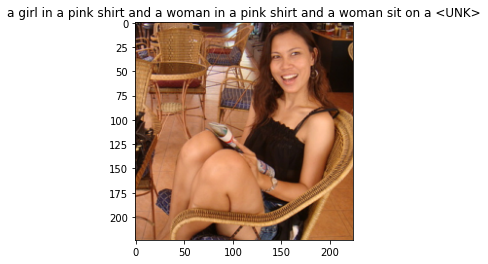

 87%|████████▋ | 1099/1265 [08:28<01:18,  2.12it/s]

Epoch: 7 loss: 2.34602


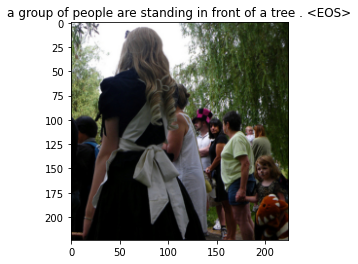

 95%|█████████▍| 1199/1265 [09:14<00:32,  2.04it/s]

Epoch: 7 loss: 2.36602


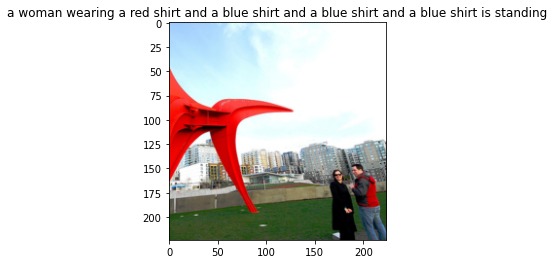

  8%|▊         | 99/1265 [00:45<09:00,  2.16it/s]

Epoch: 8 loss: 2.26210


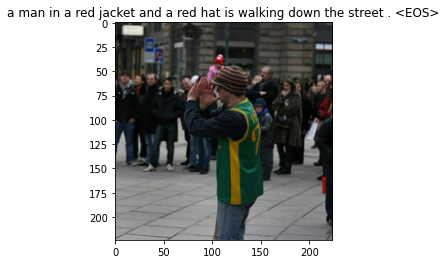

 16%|█▌        | 199/1265 [01:31<08:24,  2.11it/s]

Epoch: 8 loss: 2.17390


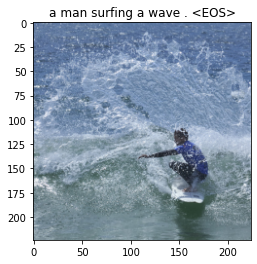

 24%|██▎       | 299/1265 [02:17<07:11,  2.24it/s]

Epoch: 8 loss: 2.27424


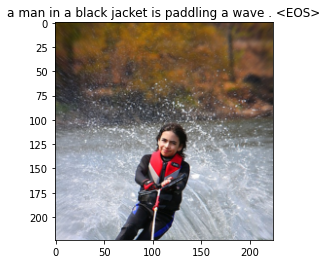

 32%|███▏      | 399/1265 [03:03<06:24,  2.25it/s]

Epoch: 8 loss: 2.39482


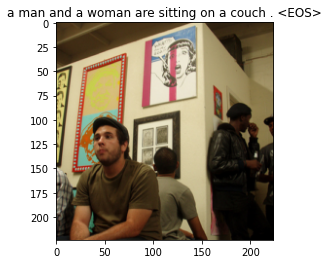

 39%|███▉      | 499/1265 [03:50<05:36,  2.28it/s]

Epoch: 8 loss: 2.16172


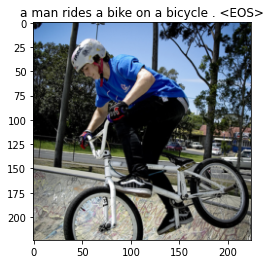

 47%|████▋     | 599/1265 [04:36<04:45,  2.33it/s]

Epoch: 8 loss: 2.49045


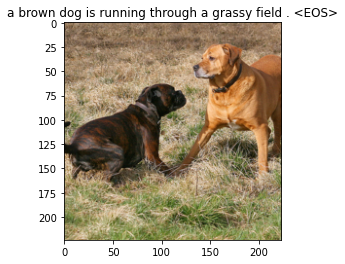

 55%|█████▌    | 699/1265 [05:23<04:13,  2.24it/s]

Epoch: 8 loss: 2.39921


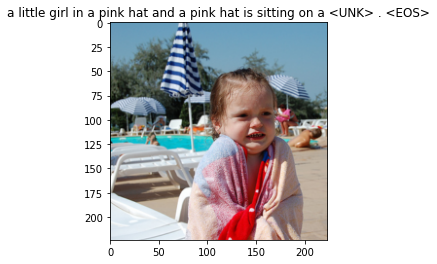

 63%|██████▎   | 799/1265 [06:09<03:26,  2.26it/s]

Epoch: 8 loss: 2.35334


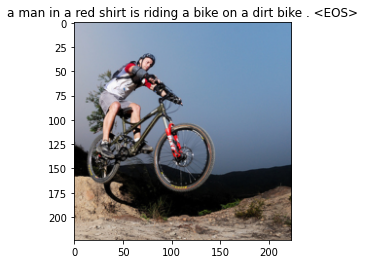

 71%|███████   | 899/1265 [06:55<02:37,  2.32it/s]

Epoch: 8 loss: 2.45856


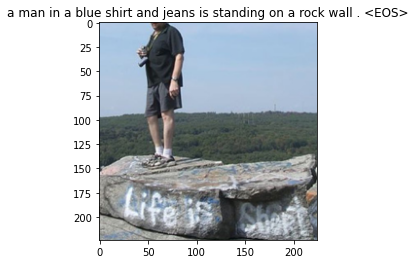

 79%|███████▉  | 999/1265 [07:41<02:04,  2.13it/s]

Epoch: 8 loss: 2.58830


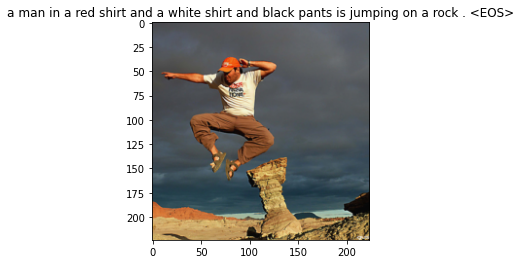

 87%|████████▋ | 1099/1265 [08:27<01:12,  2.30it/s]

Epoch: 8 loss: 2.45260


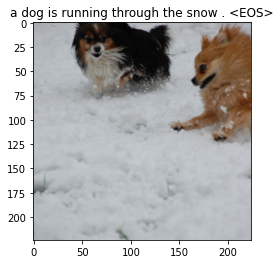

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.28it/s]

Epoch: 8 loss: 2.12034


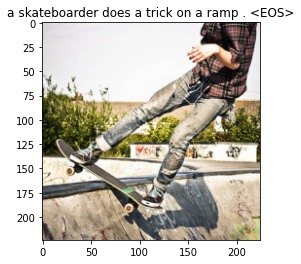

  8%|▊         | 99/1265 [00:45<08:34,  2.27it/s]

Epoch: 9 loss: 2.25944


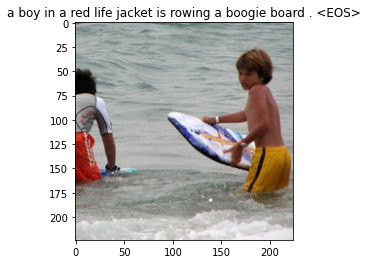

 16%|█▌        | 199/1265 [01:31<07:57,  2.23it/s]

Epoch: 9 loss: 2.42133


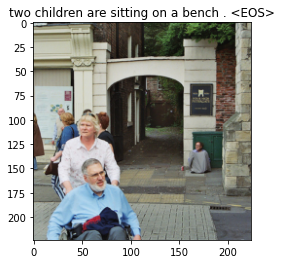

 24%|██▎       | 299/1265 [02:18<07:05,  2.27it/s]

Epoch: 9 loss: 2.10509


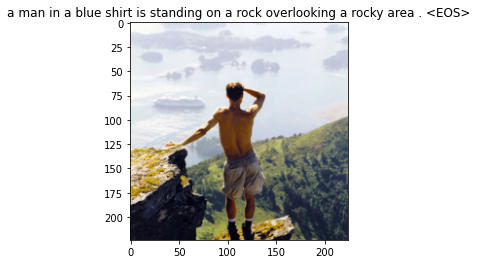

 32%|███▏      | 399/1265 [03:04<06:20,  2.27it/s]

Epoch: 9 loss: 2.53795


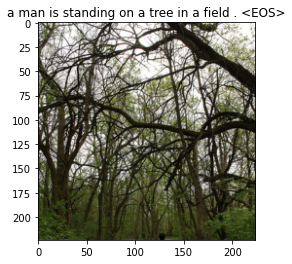

 39%|███▉      | 499/1265 [03:51<05:35,  2.28it/s]

Epoch: 9 loss: 2.09006


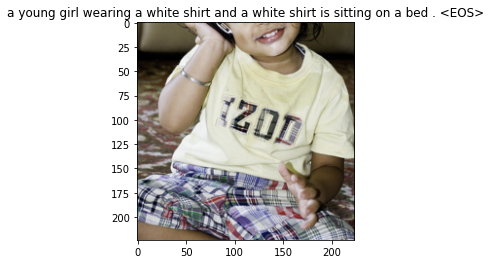

 47%|████▋     | 599/1265 [04:37<04:57,  2.24it/s]

Epoch: 9 loss: 2.31475


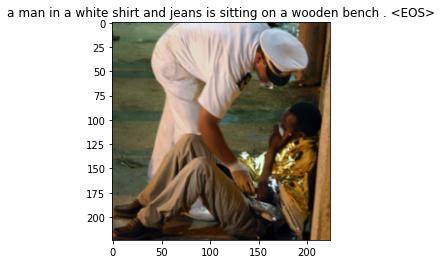

 55%|█████▌    | 699/1265 [05:24<04:10,  2.26it/s]

Epoch: 9 loss: 2.24181


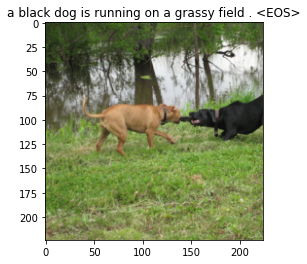

 63%|██████▎   | 799/1265 [06:10<03:46,  2.06it/s]

Epoch: 9 loss: 2.24675


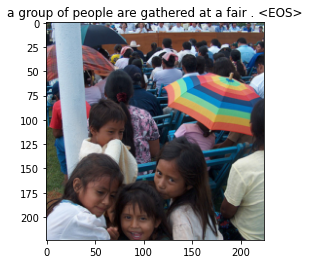

 71%|███████   | 899/1265 [06:56<02:40,  2.29it/s]

Epoch: 9 loss: 2.21628


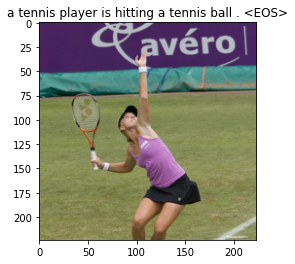

 79%|███████▉  | 999/1265 [07:42<01:55,  2.30it/s]

Epoch: 9 loss: 2.19194


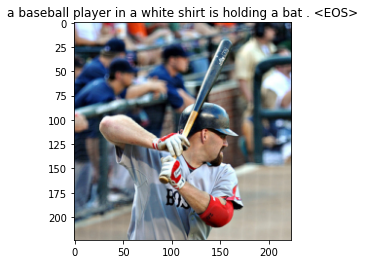

 87%|████████▋ | 1099/1265 [08:29<01:13,  2.27it/s]

Epoch: 9 loss: 2.43815


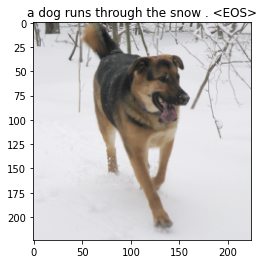

 95%|█████████▍| 1199/1265 [09:15<00:29,  2.24it/s]

Epoch: 9 loss: 2.20870


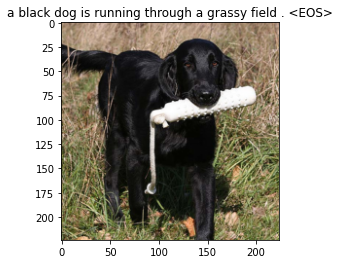

  8%|▊         | 99/1265 [00:44<09:10,  2.12it/s]

Epoch: 10 loss: 2.20394


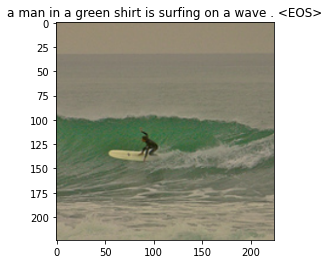

 16%|█▌        | 199/1265 [01:30<07:50,  2.27it/s]

Epoch: 10 loss: 2.14867


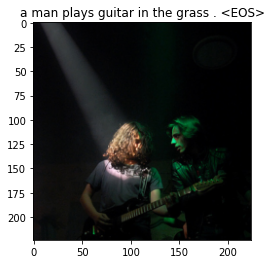

 24%|██▎       | 299/1265 [02:16<07:03,  2.28it/s]

Epoch: 10 loss: 2.02670


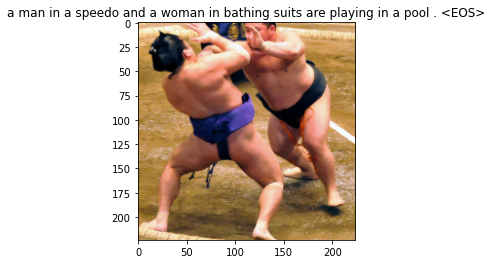

 32%|███▏      | 399/1265 [03:03<06:40,  2.16it/s]

Epoch: 10 loss: 2.21795


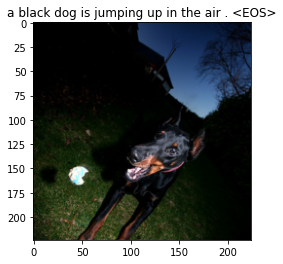

 39%|███▉      | 499/1265 [03:50<05:37,  2.27it/s]

Epoch: 10 loss: 2.36877


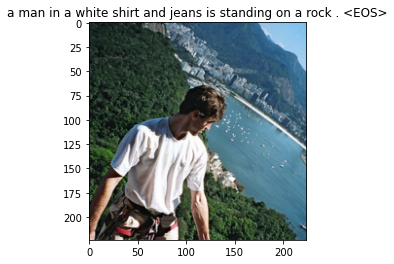

 47%|████▋     | 599/1265 [04:36<04:48,  2.31it/s]

Epoch: 10 loss: 2.28789


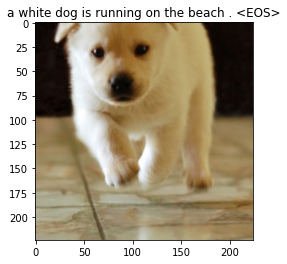

 55%|█████▌    | 699/1265 [05:23<04:08,  2.27it/s]

Epoch: 10 loss: 2.07212


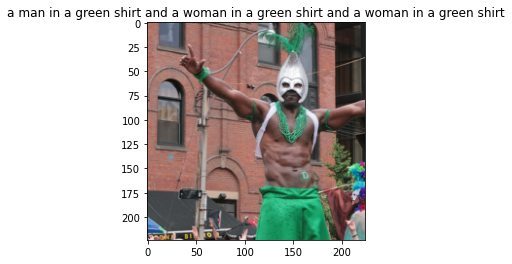

 63%|██████▎   | 799/1265 [06:09<03:46,  2.06it/s]

Epoch: 10 loss: 2.08911


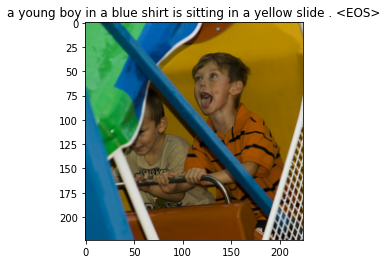

 71%|███████   | 899/1265 [06:55<02:39,  2.29it/s]

Epoch: 10 loss: 2.32303


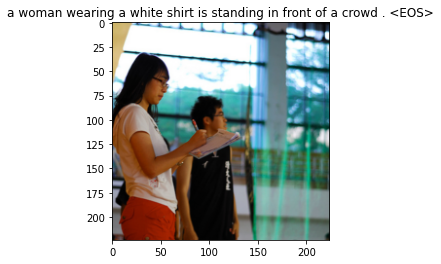

 79%|███████▉  | 999/1265 [07:42<01:57,  2.26it/s]

Epoch: 10 loss: 2.20223


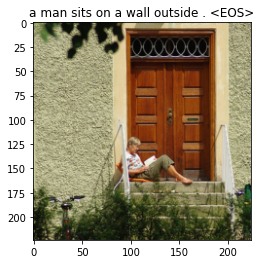

 87%|████████▋ | 1099/1265 [08:28<01:13,  2.27it/s]

Epoch: 10 loss: 2.38435


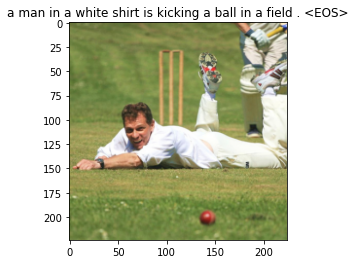

 95%|█████████▍| 1199/1265 [09:15<00:32,  2.05it/s]

Epoch: 10 loss: 2.26617


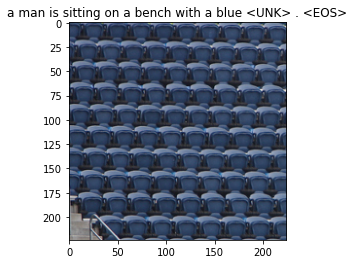

  8%|▊         | 99/1265 [00:45<08:34,  2.27it/s]

Epoch: 11 loss: 2.08618


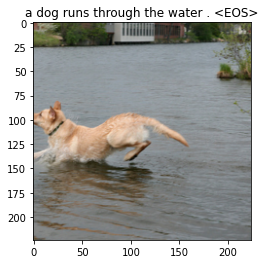

 16%|█▌        | 199/1265 [01:31<07:49,  2.27it/s]

Epoch: 11 loss: 2.34504


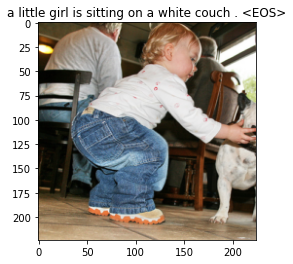

 24%|██▎       | 299/1265 [02:17<06:51,  2.35it/s]

Epoch: 11 loss: 2.21691


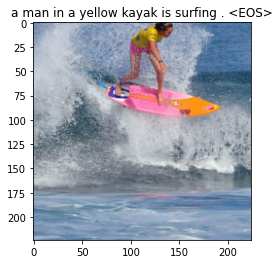

 32%|███▏      | 399/1265 [03:04<06:44,  2.14it/s]

Epoch: 11 loss: 2.15098


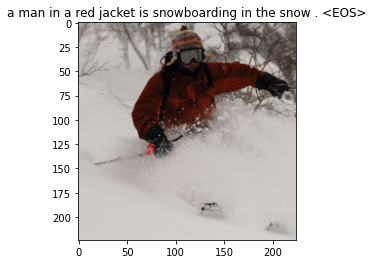

 39%|███▉      | 499/1265 [03:50<05:35,  2.28it/s]

Epoch: 11 loss: 2.27811


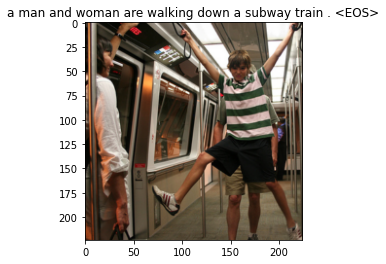

 47%|████▋     | 599/1265 [04:37<05:10,  2.14it/s]

Epoch: 11 loss: 2.10256


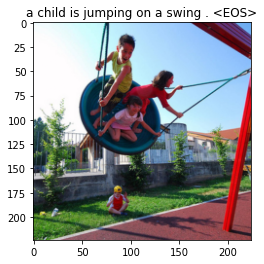

 55%|█████▌    | 699/1265 [05:23<04:11,  2.25it/s]

Epoch: 11 loss: 2.26645


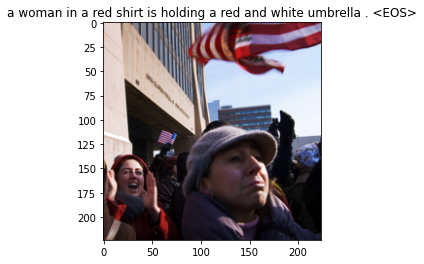

 63%|██████▎   | 799/1265 [06:10<03:28,  2.23it/s]

Epoch: 11 loss: 2.12065


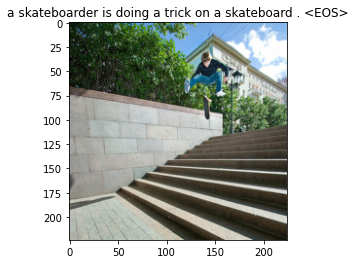

 71%|███████   | 899/1265 [06:57<02:37,  2.32it/s]

Epoch: 11 loss: 2.23312


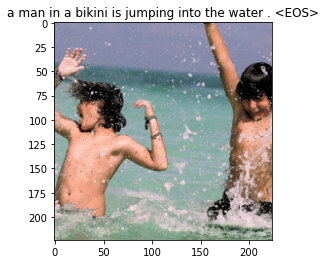

 79%|███████▉  | 999/1265 [07:43<01:59,  2.23it/s]

Epoch: 11 loss: 2.01249


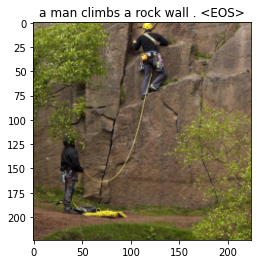

 87%|████████▋ | 1099/1265 [08:29<01:13,  2.27it/s]

Epoch: 11 loss: 2.18257


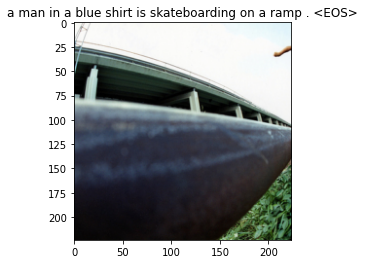

 95%|█████████▍| 1199/1265 [09:16<00:31,  2.10it/s]

Epoch: 11 loss: 2.15848


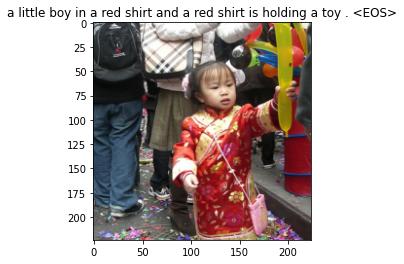

  8%|▊         | 99/1265 [00:45<08:47,  2.21it/s]

Epoch: 12 loss: 2.26999


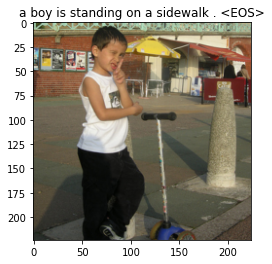

 16%|█▌        | 199/1265 [01:31<07:53,  2.25it/s]

Epoch: 12 loss: 2.10593


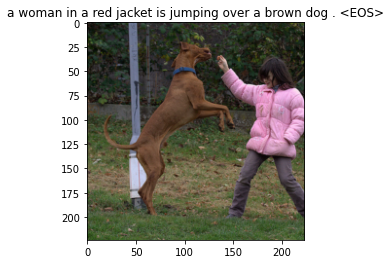

 24%|██▎       | 299/1265 [02:17<07:03,  2.28it/s]

Epoch: 12 loss: 2.10549


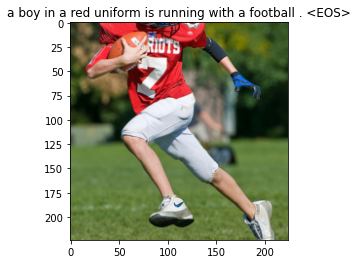

 32%|███▏      | 399/1265 [03:03<06:54,  2.09it/s]

Epoch: 12 loss: 1.98022


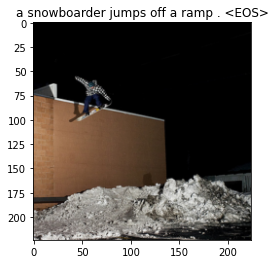

 39%|███▉      | 499/1265 [03:49<05:40,  2.25it/s]

Epoch: 12 loss: 2.24198


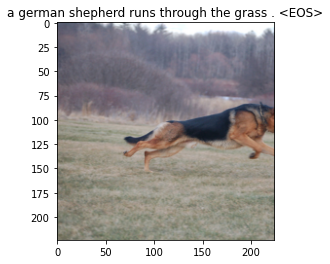

 47%|████▋     | 599/1265 [04:35<05:11,  2.14it/s]

Epoch: 12 loss: 2.22133


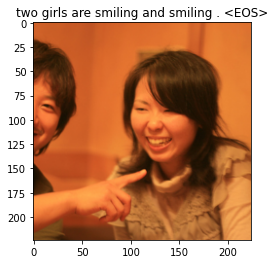

 55%|█████▌    | 699/1265 [05:22<04:13,  2.23it/s]

Epoch: 12 loss: 2.19189


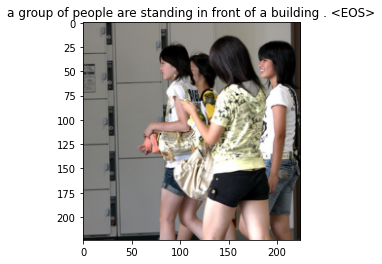

 63%|██████▎   | 799/1265 [06:08<03:22,  2.30it/s]

Epoch: 12 loss: 2.00451


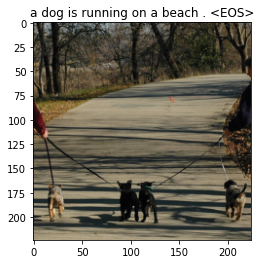

 71%|███████   | 899/1265 [06:55<02:54,  2.10it/s]

Epoch: 12 loss: 2.19898


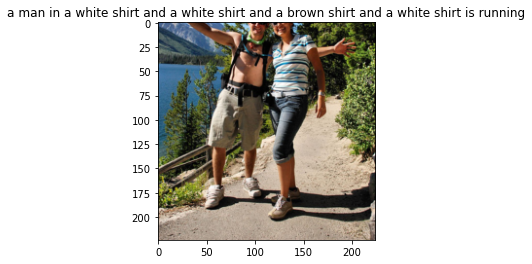

 79%|███████▉  | 999/1265 [07:41<02:00,  2.20it/s]

Epoch: 12 loss: 2.08729


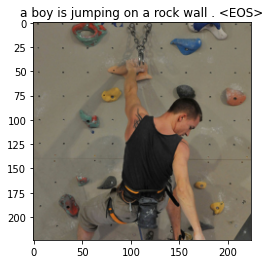

 87%|████████▋ | 1099/1265 [08:28<01:13,  2.27it/s]

Epoch: 12 loss: 2.16954


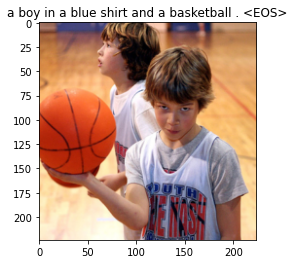

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.29it/s]

Epoch: 12 loss: 2.04632


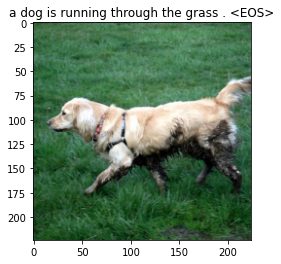

  8%|▊         | 99/1265 [00:45<08:32,  2.28it/s]

Epoch: 13 loss: 2.16179


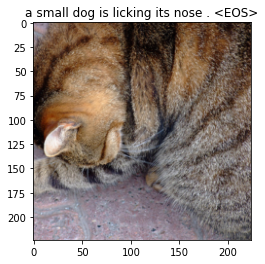

 16%|█▌        | 199/1265 [01:31<08:19,  2.13it/s]

Epoch: 13 loss: 2.04489


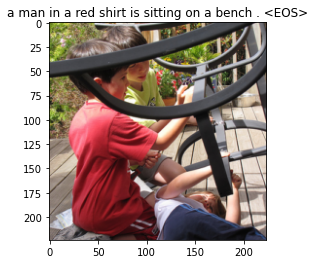

 24%|██▎       | 299/1265 [02:17<07:05,  2.27it/s]

Epoch: 13 loss: 1.96871


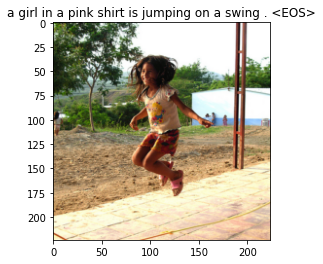

 32%|███▏      | 399/1265 [03:04<06:26,  2.24it/s]

Epoch: 13 loss: 2.10989


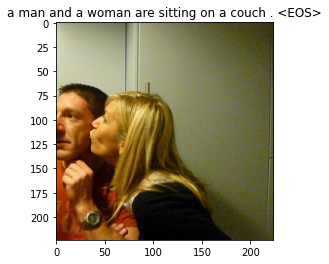

 39%|███▉      | 499/1265 [03:50<05:36,  2.27it/s]

Epoch: 13 loss: 2.22427


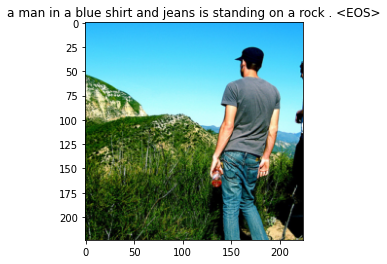

 47%|████▋     | 599/1265 [04:37<05:13,  2.12it/s]

Epoch: 13 loss: 1.99434


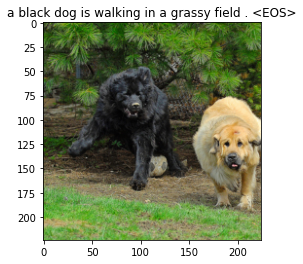

 55%|█████▌    | 699/1265 [05:23<04:05,  2.30it/s]

Epoch: 13 loss: 2.37837


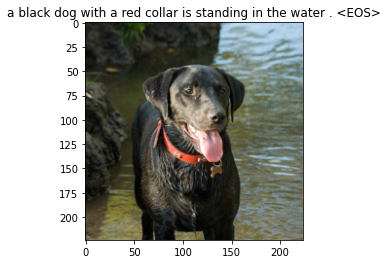

 63%|██████▎   | 799/1265 [06:09<03:42,  2.10it/s]

Epoch: 13 loss: 2.14639


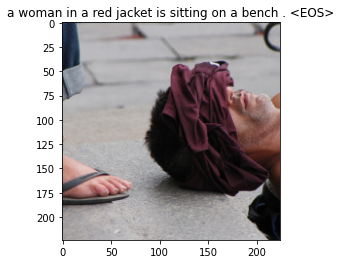

 71%|███████   | 899/1265 [06:55<02:55,  2.09it/s]

Epoch: 13 loss: 2.19875


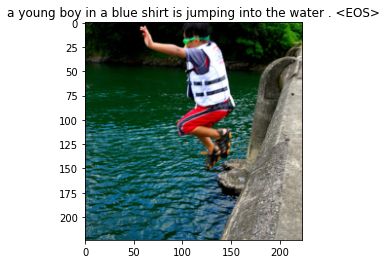

 79%|███████▉  | 999/1265 [07:41<01:56,  2.28it/s]

Epoch: 13 loss: 2.11692


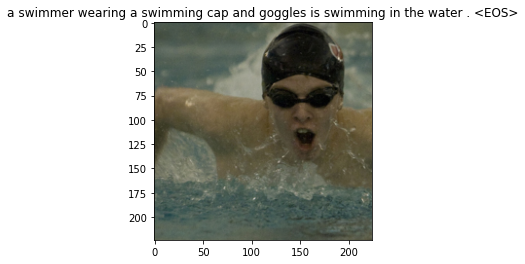

 87%|████████▋ | 1099/1265 [08:28<01:22,  2.01it/s]

Epoch: 13 loss: 2.06339


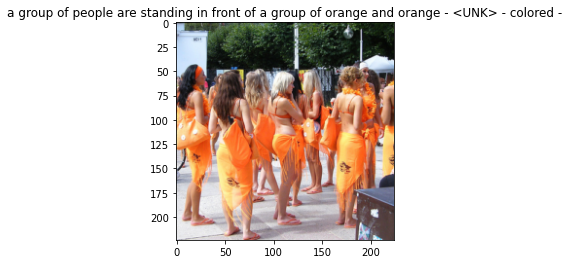

 95%|█████████▍| 1199/1265 [09:14<00:29,  2.26it/s]

Epoch: 13 loss: 2.05174


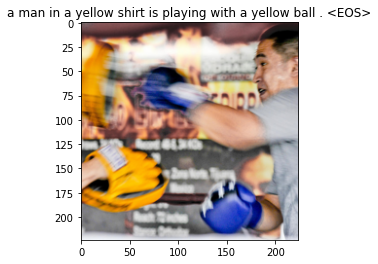

  8%|▊         | 99/1265 [00:45<09:35,  2.03it/s]

Epoch: 14 loss: 2.07876


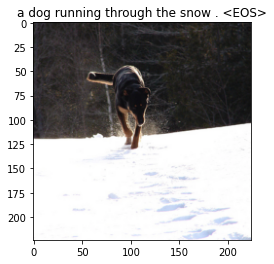

 16%|█▌        | 199/1265 [01:31<07:46,  2.28it/s]

Epoch: 14 loss: 1.84944


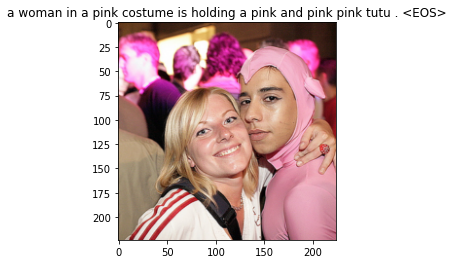

 24%|██▎       | 299/1265 [02:17<07:37,  2.11it/s]

Epoch: 14 loss: 2.04811


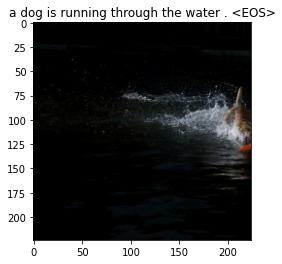

 32%|███▏      | 399/1265 [03:04<06:55,  2.08it/s]

Epoch: 14 loss: 2.04529


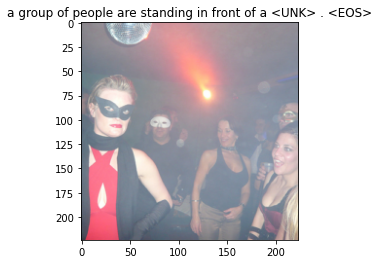

 39%|███▉      | 499/1265 [03:49<05:35,  2.28it/s]

Epoch: 14 loss: 2.18891


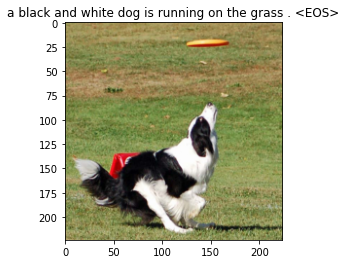

 47%|████▋     | 599/1265 [04:36<04:49,  2.30it/s]

Epoch: 14 loss: 2.03353


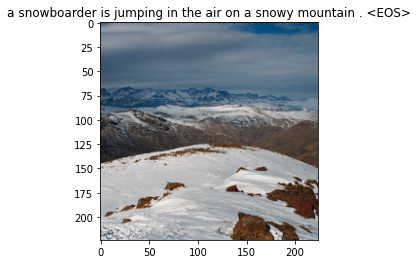

 55%|█████▌    | 699/1265 [05:22<04:02,  2.33it/s]

Epoch: 14 loss: 2.21334


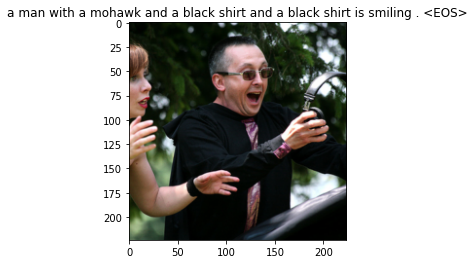

 63%|██████▎   | 799/1265 [06:08<03:24,  2.28it/s]

Epoch: 14 loss: 2.12267


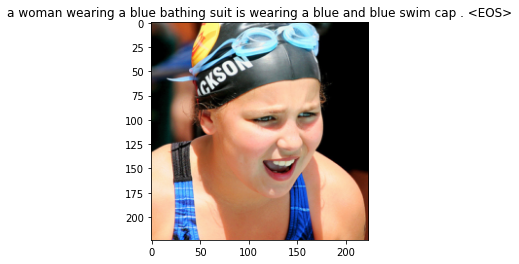

 71%|███████   | 899/1265 [06:54<02:44,  2.23it/s]

Epoch: 14 loss: 2.08729


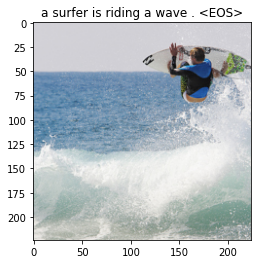

 79%|███████▉  | 999/1265 [07:40<01:53,  2.34it/s]

Epoch: 14 loss: 1.91434


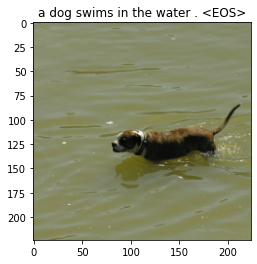

 87%|████████▋ | 1099/1265 [08:26<01:13,  2.27it/s]

Epoch: 14 loss: 2.22072


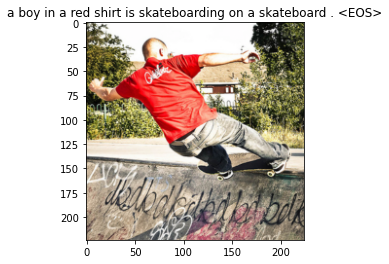

 95%|█████████▍| 1199/1265 [09:13<00:31,  2.08it/s]

Epoch: 14 loss: 2.00626


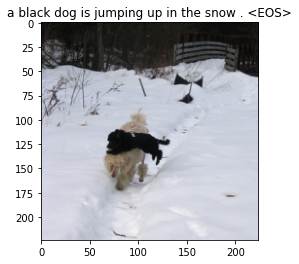

  8%|▊         | 99/1265 [00:45<08:23,  2.31it/s]

Epoch: 15 loss: 2.01263


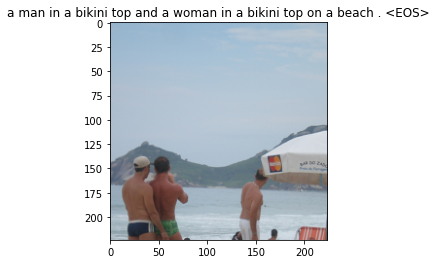

 16%|█▌        | 199/1265 [01:31<07:52,  2.25it/s]

Epoch: 15 loss: 2.22466


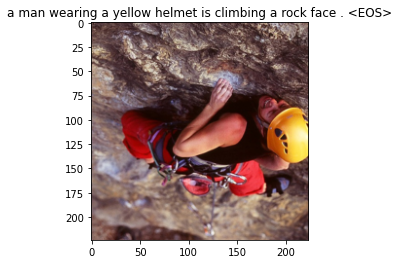

 24%|██▎       | 299/1265 [02:17<07:49,  2.06it/s]

Epoch: 15 loss: 2.02114


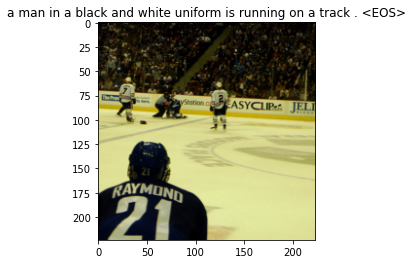

 32%|███▏      | 399/1265 [03:04<06:17,  2.29it/s]

Epoch: 15 loss: 1.75953


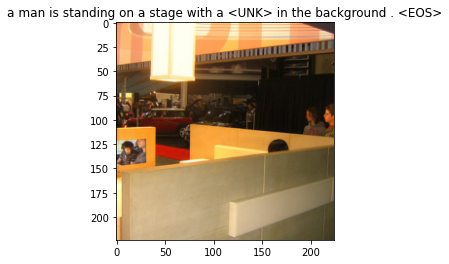

 39%|███▉      | 499/1265 [03:50<05:31,  2.31it/s]

Epoch: 15 loss: 2.18056


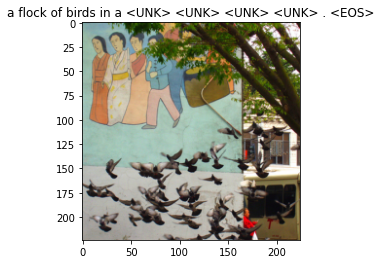

 47%|████▋     | 599/1265 [04:36<05:22,  2.06it/s]

Epoch: 15 loss: 1.96821


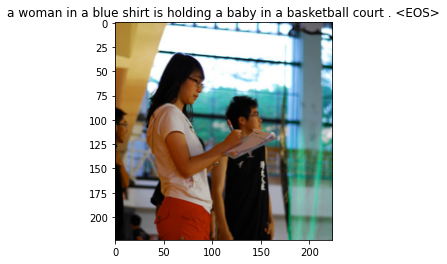

 55%|█████▌    | 699/1265 [05:22<04:10,  2.26it/s]

Epoch: 15 loss: 1.91250


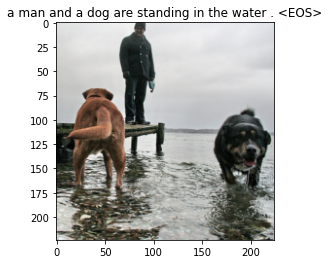

 63%|██████▎   | 799/1265 [06:09<03:25,  2.27it/s]

Epoch: 15 loss: 2.15604


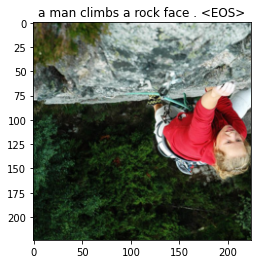

 71%|███████   | 899/1265 [06:55<03:00,  2.03it/s]

Epoch: 15 loss: 2.01328


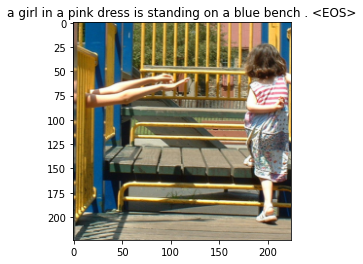

 79%|███████▉  | 999/1265 [07:41<01:55,  2.30it/s]

Epoch: 15 loss: 2.21319


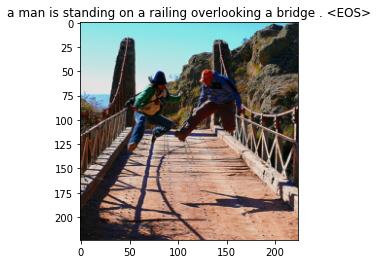

 87%|████████▋ | 1099/1265 [08:27<01:18,  2.10it/s]

Epoch: 15 loss: 2.34268


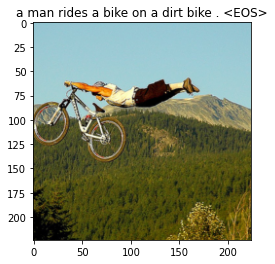

 95%|█████████▍| 1199/1265 [09:14<00:32,  2.03it/s]

Epoch: 15 loss: 1.89047


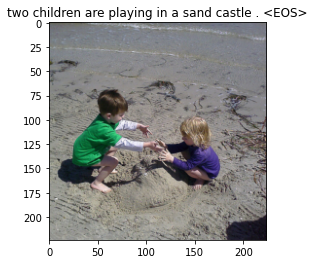

  8%|▊         | 99/1265 [00:45<08:27,  2.30it/s]

Epoch: 16 loss: 2.13724


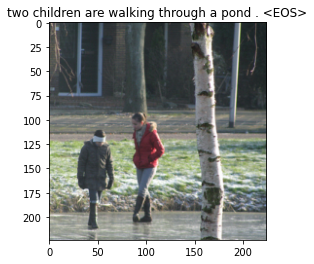

 16%|█▌        | 199/1265 [01:31<07:50,  2.27it/s]

Epoch: 16 loss: 1.91965


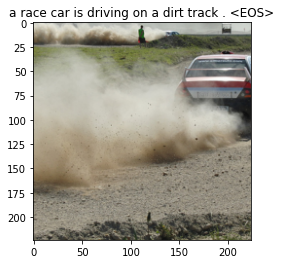

 24%|██▎       | 299/1265 [02:17<07:09,  2.25it/s]

Epoch: 16 loss: 1.93810


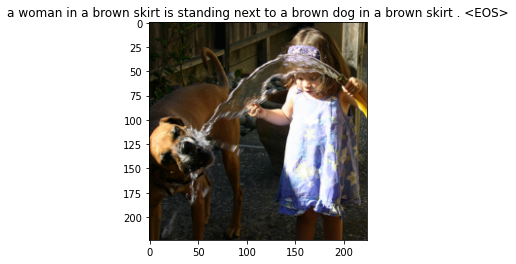

 32%|███▏      | 399/1265 [03:03<06:20,  2.28it/s]

Epoch: 16 loss: 1.92620


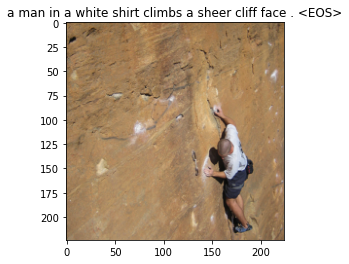

 39%|███▉      | 499/1265 [03:50<06:11,  2.06it/s]

Epoch: 16 loss: 1.97831


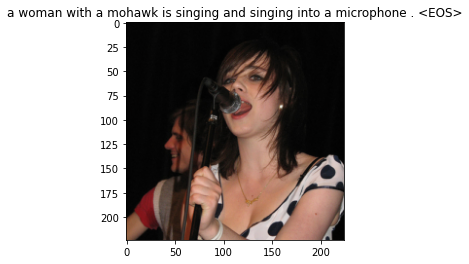

 47%|████▋     | 599/1265 [04:37<04:58,  2.23it/s]

Epoch: 16 loss: 2.01123


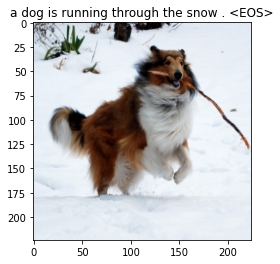

 55%|█████▌    | 699/1265 [05:23<04:25,  2.13it/s]

Epoch: 16 loss: 1.95307


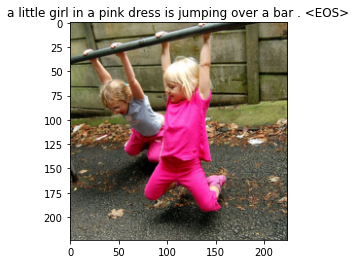

 63%|██████▎   | 799/1265 [06:10<03:23,  2.29it/s]

Epoch: 16 loss: 2.01679


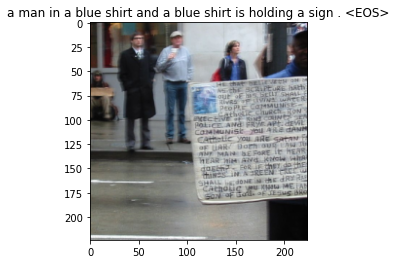

 71%|███████   | 899/1265 [06:56<02:38,  2.30it/s]

Epoch: 16 loss: 2.00776


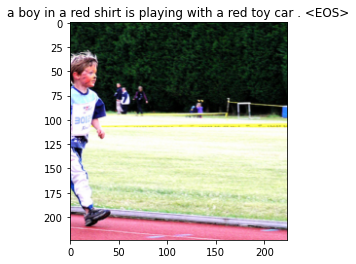

 79%|███████▉  | 999/1265 [07:42<01:58,  2.24it/s]

Epoch: 16 loss: 1.94983


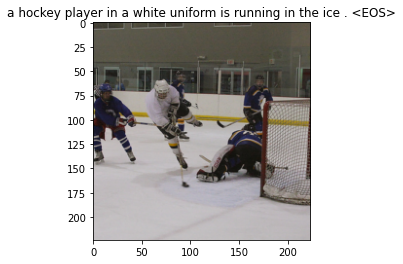

 87%|████████▋ | 1099/1265 [08:28<01:13,  2.25it/s]

Epoch: 16 loss: 2.03606


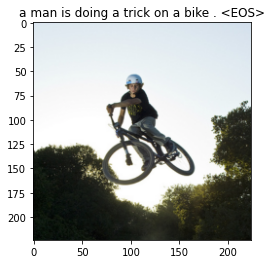

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.33it/s]

Epoch: 16 loss: 2.10972


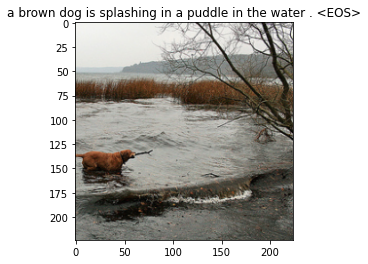

  8%|▊         | 99/1265 [00:45<09:17,  2.09it/s]

Epoch: 17 loss: 2.30085


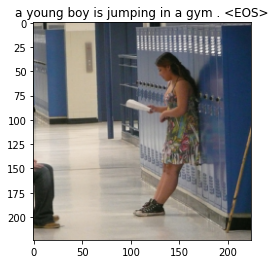

 16%|█▌        | 199/1265 [01:31<08:22,  2.12it/s]

Epoch: 17 loss: 1.83757


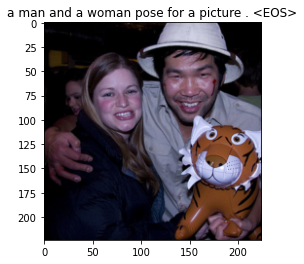

 24%|██▎       | 299/1265 [02:18<07:54,  2.04it/s]

Epoch: 17 loss: 1.95236


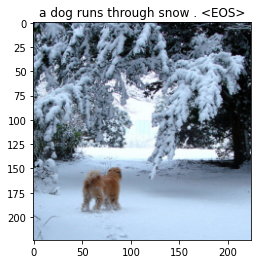

 32%|███▏      | 399/1265 [03:04<06:47,  2.13it/s]

Epoch: 17 loss: 2.08135


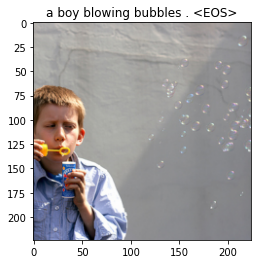

 39%|███▉      | 499/1265 [03:50<05:39,  2.26it/s]

Epoch: 17 loss: 1.95624


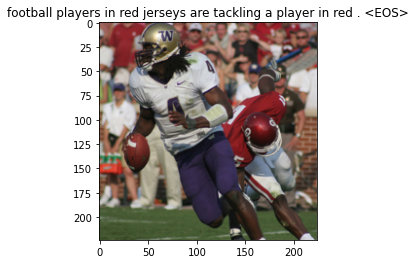

 47%|████▋     | 599/1265 [04:36<04:51,  2.28it/s]

Epoch: 17 loss: 2.06303


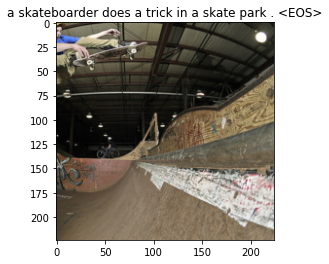

 55%|█████▌    | 699/1265 [05:23<04:31,  2.08it/s]

Epoch: 17 loss: 1.99926


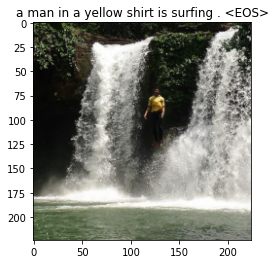

 63%|██████▎   | 799/1265 [06:09<03:50,  2.02it/s]

Epoch: 17 loss: 2.00735


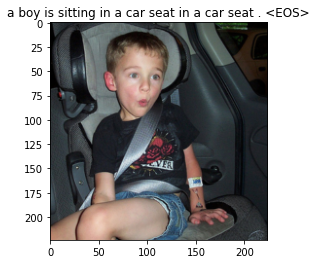

 71%|███████   | 899/1265 [06:55<02:43,  2.23it/s]

Epoch: 17 loss: 2.11232


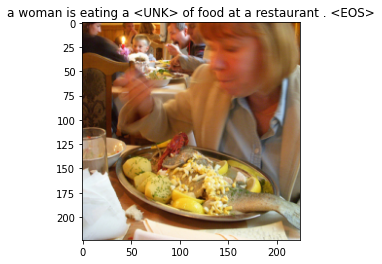

 79%|███████▉  | 999/1265 [07:41<02:08,  2.07it/s]

Epoch: 17 loss: 1.98352


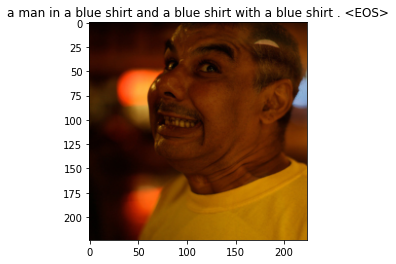

 87%|████████▋ | 1099/1265 [08:27<01:13,  2.25it/s]

Epoch: 17 loss: 1.88573


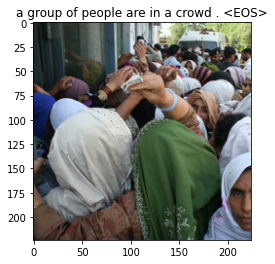

 95%|█████████▍| 1199/1265 [09:13<00:28,  2.30it/s]

Epoch: 17 loss: 2.14888


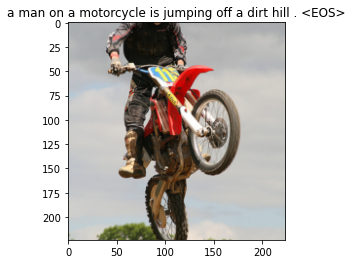

  8%|▊         | 99/1265 [00:45<09:00,  2.16it/s]

Epoch: 18 loss: 2.07487


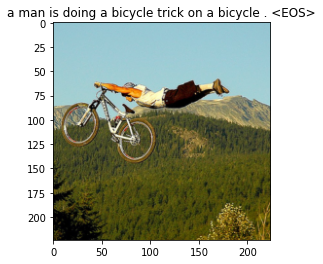

 16%|█▌        | 199/1265 [01:31<07:49,  2.27it/s]

Epoch: 18 loss: 1.79929


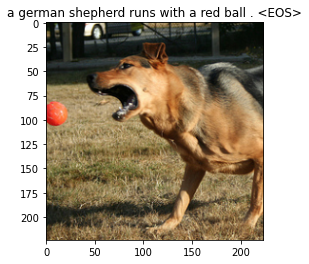

 24%|██▎       | 299/1265 [02:17<07:03,  2.28it/s]

Epoch: 18 loss: 1.95837


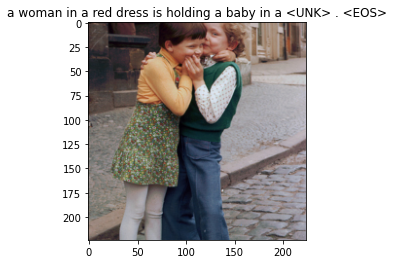

 32%|███▏      | 399/1265 [03:03<06:24,  2.25it/s]

Epoch: 18 loss: 1.75694


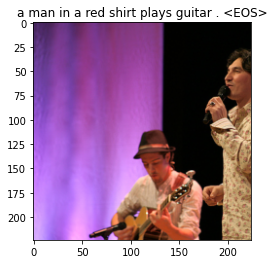

 39%|███▉      | 499/1265 [03:50<05:29,  2.32it/s]

Epoch: 18 loss: 1.82584


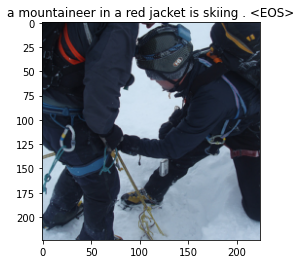

 47%|████▋     | 599/1265 [04:36<04:48,  2.30it/s]

Epoch: 18 loss: 2.07764


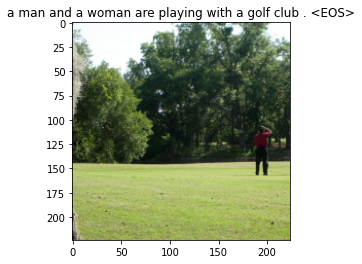

 55%|█████▌    | 699/1265 [05:23<04:16,  2.21it/s]

Epoch: 18 loss: 1.98729


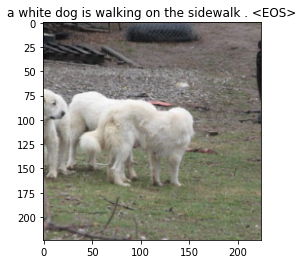

 63%|██████▎   | 799/1265 [06:09<03:29,  2.23it/s]

Epoch: 18 loss: 2.03008


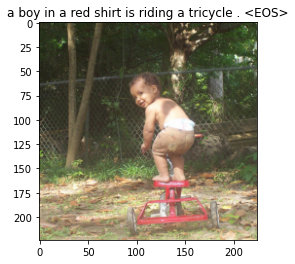

 71%|███████   | 899/1265 [06:55<02:38,  2.31it/s]

Epoch: 18 loss: 1.88827


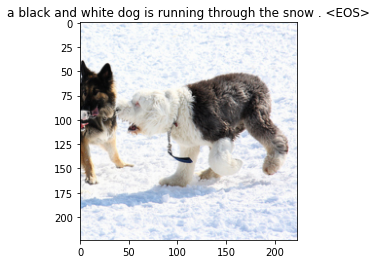

 79%|███████▉  | 999/1265 [07:41<01:56,  2.28it/s]

Epoch: 18 loss: 2.07844


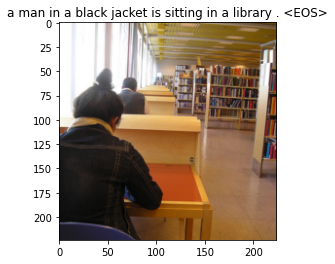

 87%|████████▋ | 1099/1265 [08:28<01:13,  2.26it/s]

Epoch: 18 loss: 1.84204


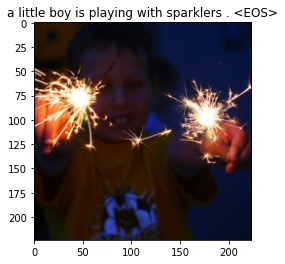

 95%|█████████▍| 1199/1265 [09:14<00:32,  2.05it/s]

Epoch: 18 loss: 2.03139


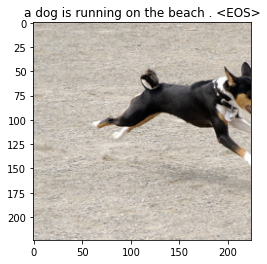

  8%|▊         | 99/1265 [00:45<08:17,  2.34it/s]

Epoch: 19 loss: 1.77210


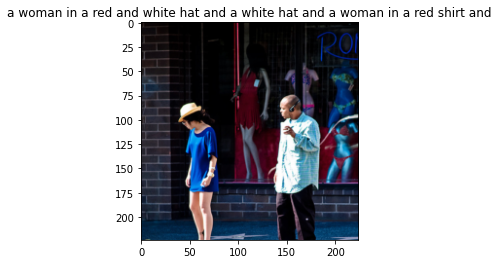

 16%|█▌        | 199/1265 [01:32<07:50,  2.27it/s]

Epoch: 19 loss: 1.69923


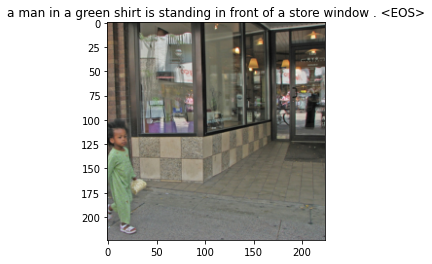

 24%|██▎       | 299/1265 [02:19<07:40,  2.10it/s]

Epoch: 19 loss: 1.92057


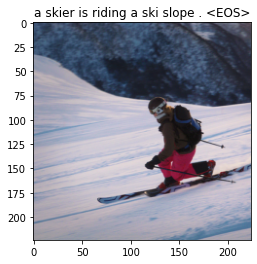

 32%|███▏      | 399/1265 [03:05<06:15,  2.30it/s]

Epoch: 19 loss: 1.88806


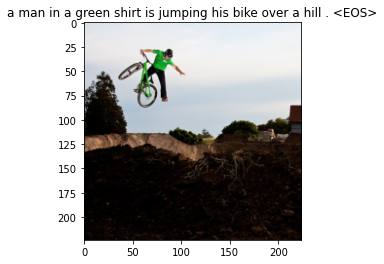

 39%|███▉      | 499/1265 [03:51<06:03,  2.11it/s]

Epoch: 19 loss: 1.94382


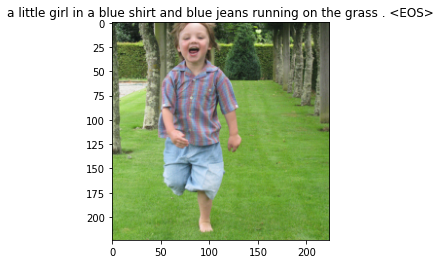

 47%|████▋     | 599/1265 [04:37<04:51,  2.29it/s]

Epoch: 19 loss: 1.92932


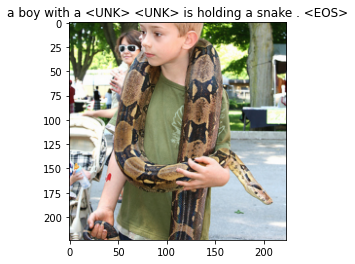

 55%|█████▌    | 699/1265 [05:23<04:27,  2.11it/s]

Epoch: 19 loss: 1.91398


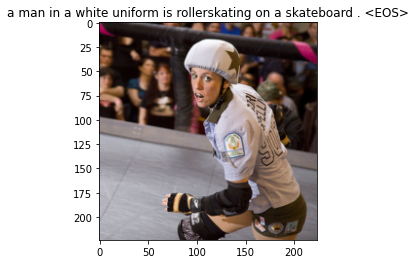

 63%|██████▎   | 799/1265 [06:09<03:27,  2.25it/s]

Epoch: 19 loss: 2.00669


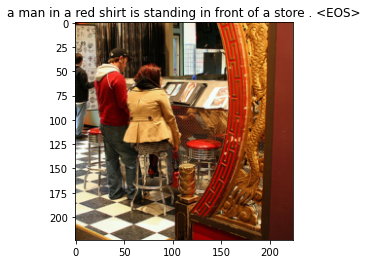

 71%|███████   | 899/1265 [06:56<02:39,  2.29it/s]

Epoch: 19 loss: 1.85908


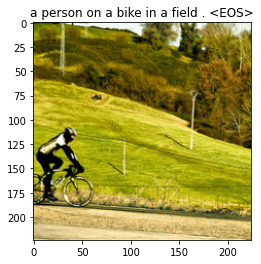

 79%|███████▉  | 999/1265 [07:42<01:55,  2.30it/s]

Epoch: 19 loss: 2.13337


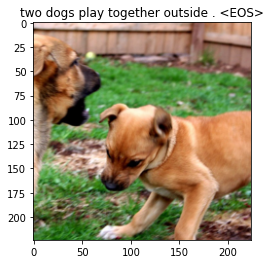

 87%|████████▋ | 1099/1265 [08:28<01:20,  2.06it/s]

Epoch: 19 loss: 2.07657


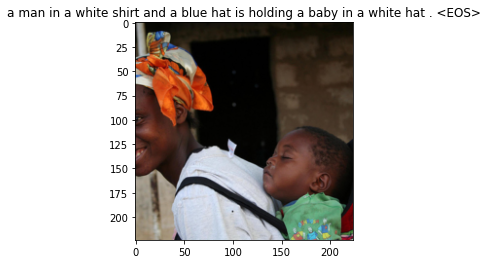

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.28it/s]

Epoch: 19 loss: 2.11876


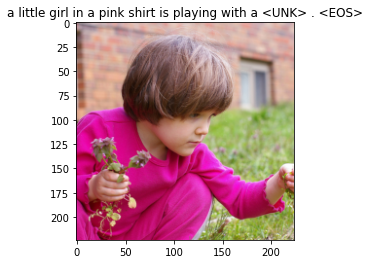

  8%|▊         | 99/1265 [00:44<09:09,  2.12it/s]

Epoch: 20 loss: 1.84749


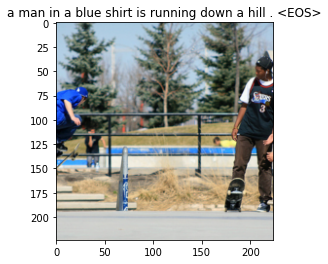

 16%|█▌        | 199/1265 [01:30<07:49,  2.27it/s]

Epoch: 20 loss: 1.87522


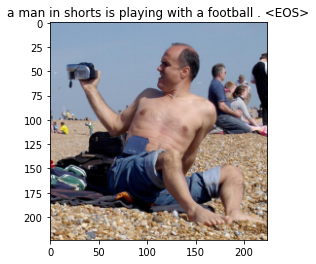

 24%|██▎       | 299/1265 [02:16<07:07,  2.26it/s]

Epoch: 20 loss: 1.84111


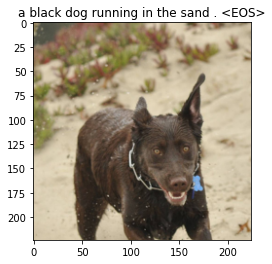

 32%|███▏      | 399/1265 [03:03<06:50,  2.11it/s]

Epoch: 20 loss: 1.74808


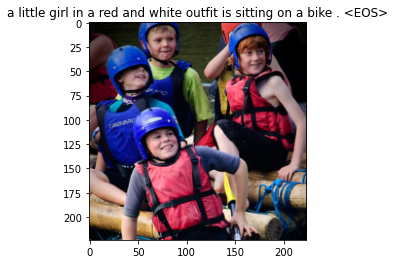

 39%|███▉      | 499/1265 [03:49<05:34,  2.29it/s]

Epoch: 20 loss: 1.84817


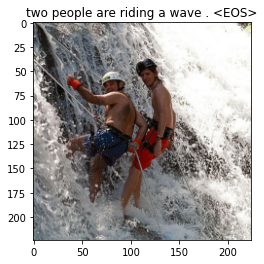

 47%|████▋     | 599/1265 [04:35<05:12,  2.13it/s]

Epoch: 20 loss: 1.88187


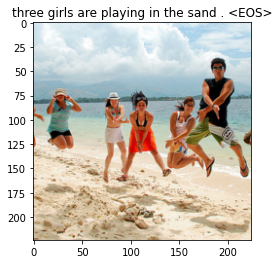

 55%|█████▌    | 699/1265 [05:21<04:09,  2.27it/s]

Epoch: 20 loss: 1.89128


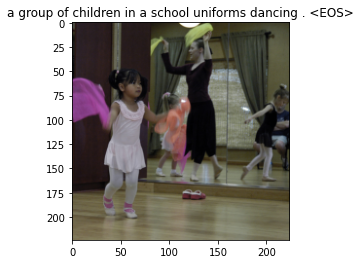

 63%|██████▎   | 799/1265 [06:08<03:26,  2.26it/s]

Epoch: 20 loss: 2.03341


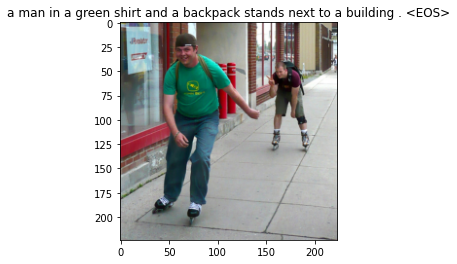

 71%|███████   | 899/1265 [06:54<02:37,  2.32it/s]

Epoch: 20 loss: 1.95792


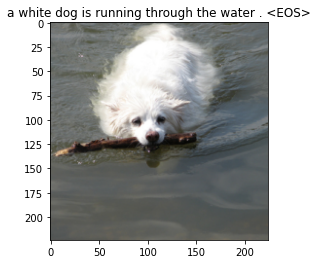

 79%|███████▉  | 999/1265 [07:41<02:06,  2.11it/s]

Epoch: 20 loss: 1.95105


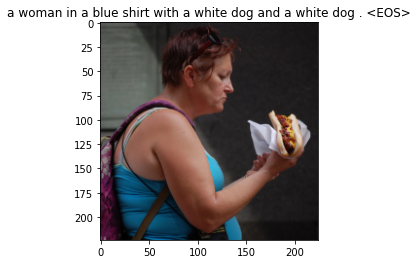

 87%|████████▋ | 1099/1265 [08:27<01:13,  2.26it/s]

Epoch: 20 loss: 2.07032


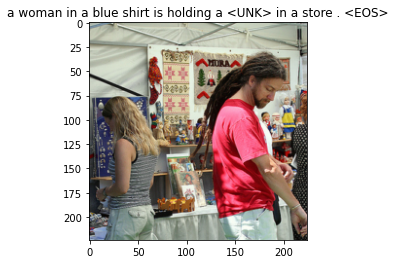

 95%|█████████▍| 1199/1265 [09:13<00:28,  2.32it/s]

Epoch: 20 loss: 2.22064


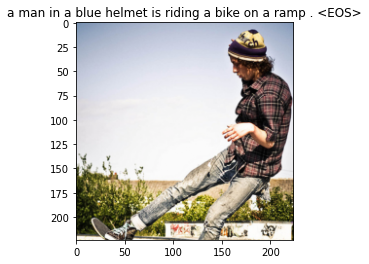

  8%|▊         | 99/1265 [00:44<08:28,  2.29it/s]

Epoch: 21 loss: 1.92234


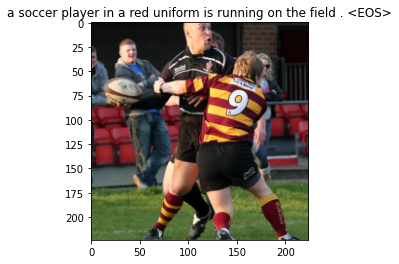

 16%|█▌        | 199/1265 [01:30<07:42,  2.30it/s]

Epoch: 21 loss: 1.83683


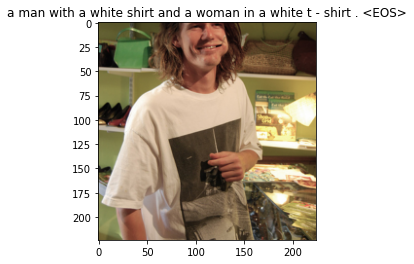

 24%|██▎       | 299/1265 [02:17<07:20,  2.20it/s]

Epoch: 21 loss: 1.83208


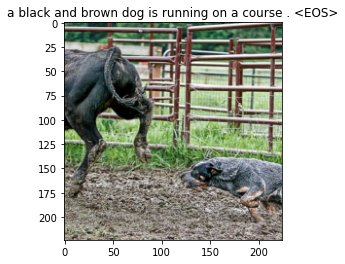

 32%|███▏      | 399/1265 [03:03<06:59,  2.06it/s]

Epoch: 21 loss: 1.98616


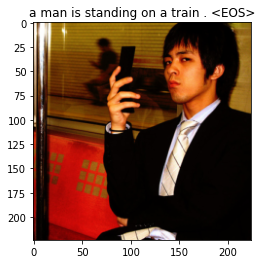

 39%|███▉      | 499/1265 [03:50<06:01,  2.12it/s]

Epoch: 21 loss: 2.04369


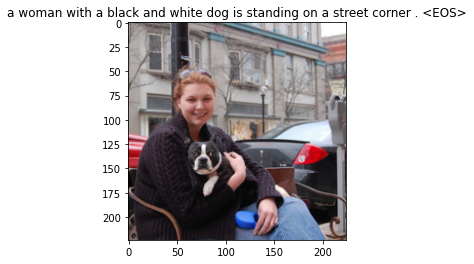

 47%|████▋     | 599/1265 [04:35<04:46,  2.33it/s]

Epoch: 21 loss: 1.98604


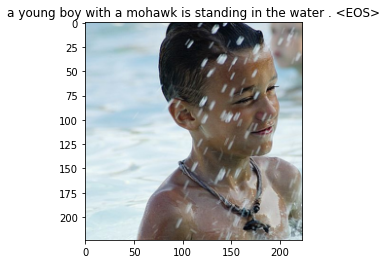

 55%|█████▌    | 699/1265 [05:22<04:11,  2.25it/s]

Epoch: 21 loss: 1.93349


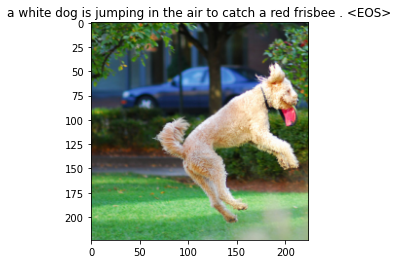

 63%|██████▎   | 799/1265 [06:08<03:24,  2.28it/s]

Epoch: 21 loss: 1.98314


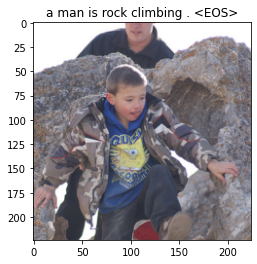

 71%|███████   | 899/1265 [06:54<02:40,  2.28it/s]

Epoch: 21 loss: 1.78088


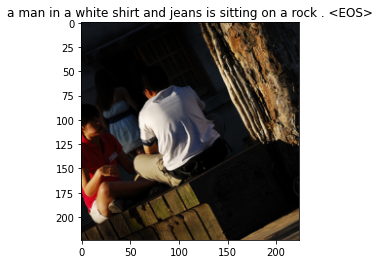

 79%|███████▉  | 999/1265 [07:41<02:06,  2.10it/s]

Epoch: 21 loss: 1.98086


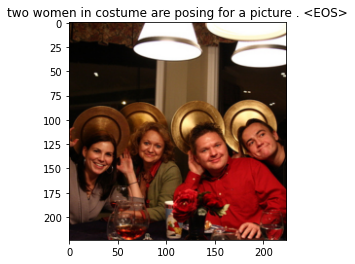

 87%|████████▋ | 1099/1265 [08:27<01:18,  2.11it/s]

Epoch: 21 loss: 1.91478


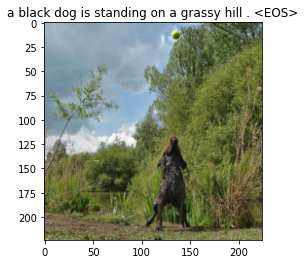

 95%|█████████▍| 1199/1265 [09:14<00:29,  2.22it/s]

Epoch: 21 loss: 1.84560


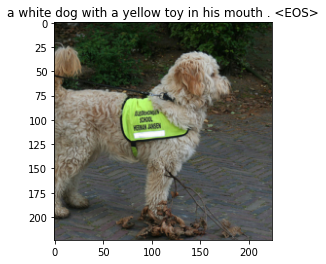

  8%|▊         | 99/1265 [00:45<08:22,  2.32it/s]

Epoch: 22 loss: 1.79223


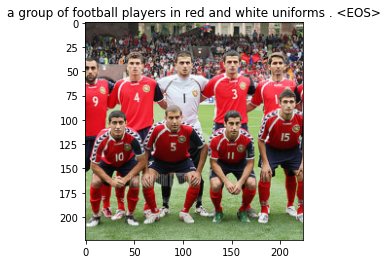

 16%|█▌        | 199/1265 [01:32<08:26,  2.10it/s]

Epoch: 22 loss: 1.78093


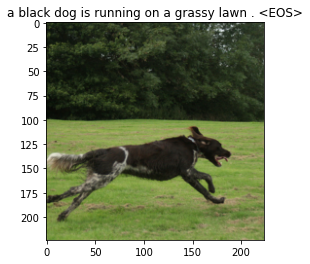

 24%|██▎       | 299/1265 [02:18<07:09,  2.25it/s]

Epoch: 22 loss: 1.80355


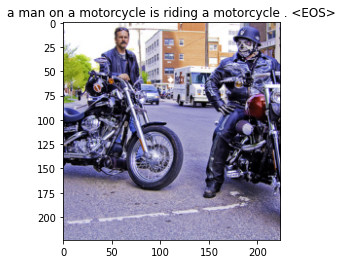

 32%|███▏      | 399/1265 [03:04<06:10,  2.34it/s]

Epoch: 22 loss: 1.83549


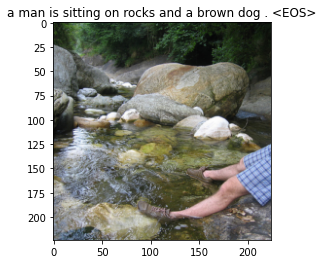

 39%|███▉      | 499/1265 [03:51<05:42,  2.23it/s]

Epoch: 22 loss: 2.00116


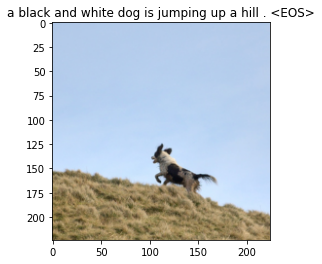

 47%|████▋     | 599/1265 [04:37<04:50,  2.29it/s]

Epoch: 22 loss: 1.86232


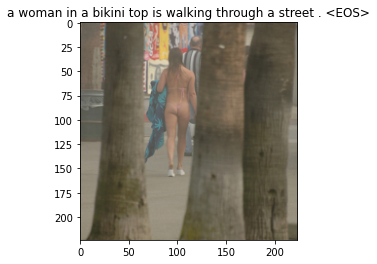

 55%|█████▌    | 699/1265 [05:23<04:29,  2.10it/s]

Epoch: 22 loss: 1.68617


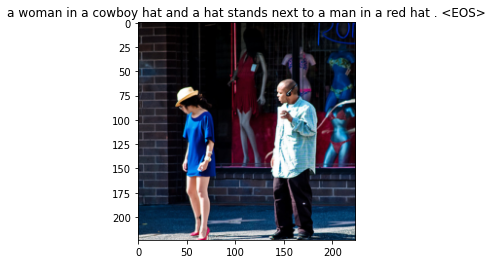

 63%|██████▎   | 799/1265 [06:09<03:21,  2.31it/s]

Epoch: 22 loss: 2.04242


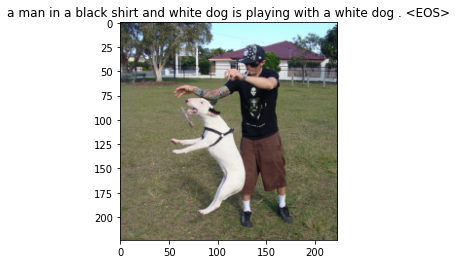

 71%|███████   | 899/1265 [06:55<02:35,  2.35it/s]

Epoch: 22 loss: 2.04648


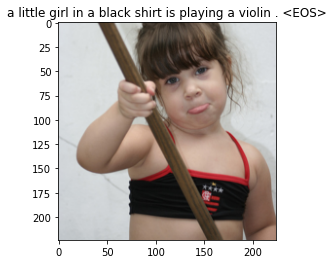

 79%|███████▉  | 999/1265 [07:42<01:55,  2.30it/s]

Epoch: 22 loss: 1.89921


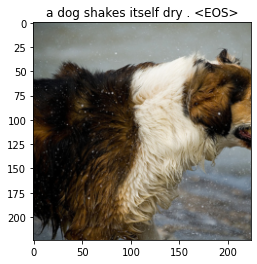

 87%|████████▋ | 1099/1265 [08:28<01:18,  2.10it/s]

Epoch: 22 loss: 2.02429


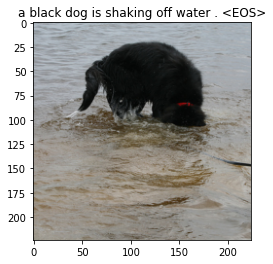

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.29it/s]

Epoch: 22 loss: 1.75732


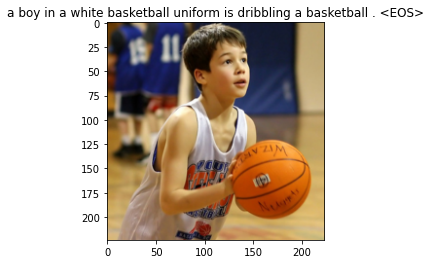

  8%|▊         | 99/1265 [00:45<09:24,  2.07it/s]

Epoch: 23 loss: 1.66791


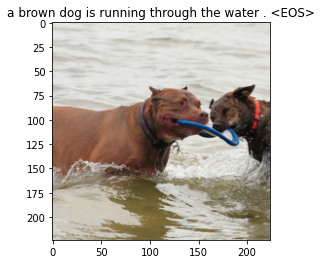

 16%|█▌        | 199/1265 [01:31<07:50,  2.27it/s]

Epoch: 23 loss: 2.04049


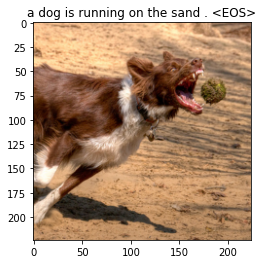

 24%|██▎       | 299/1265 [02:17<07:01,  2.29it/s]

Epoch: 23 loss: 1.99005


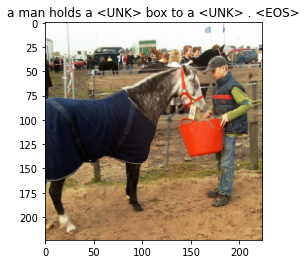

 32%|███▏      | 399/1265 [03:04<06:46,  2.13it/s]

Epoch: 23 loss: 1.90869


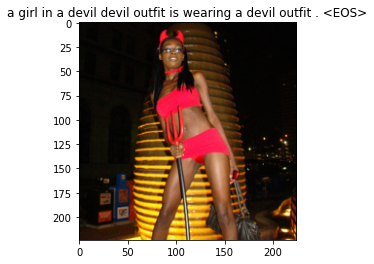

 39%|███▉      | 499/1265 [03:50<05:39,  2.25it/s]

Epoch: 23 loss: 1.75507


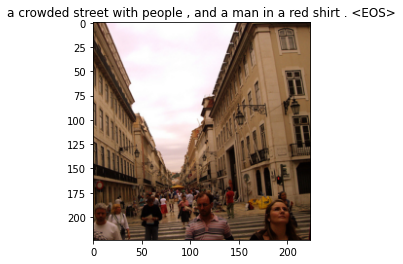

 47%|████▋     | 599/1265 [04:37<05:23,  2.06it/s]

Epoch: 23 loss: 1.75058


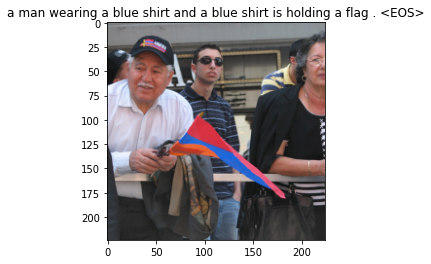

 55%|█████▌    | 699/1265 [05:23<04:11,  2.25it/s]

Epoch: 23 loss: 1.84450


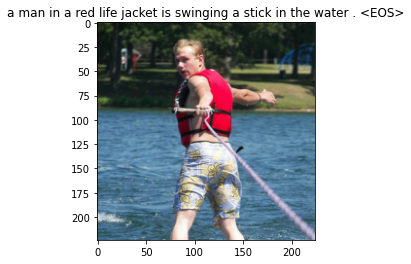

 63%|██████▎   | 799/1265 [06:09<03:23,  2.29it/s]

Epoch: 23 loss: 1.88756


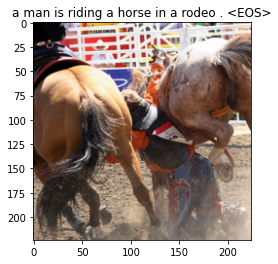

 71%|███████   | 899/1265 [06:55<02:41,  2.27it/s]

Epoch: 23 loss: 1.69456


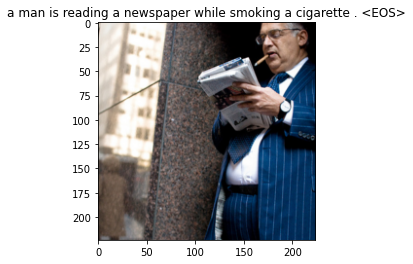

 79%|███████▉  | 999/1265 [07:42<01:58,  2.24it/s]

Epoch: 23 loss: 1.83542


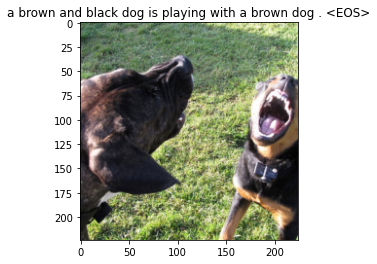

 87%|████████▋ | 1099/1265 [08:28<01:18,  2.13it/s]

Epoch: 23 loss: 1.88634


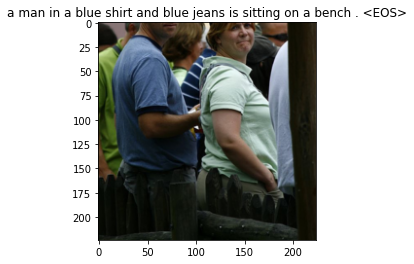

 95%|█████████▍| 1199/1265 [09:14<00:29,  2.25it/s]

Epoch: 23 loss: 1.87335


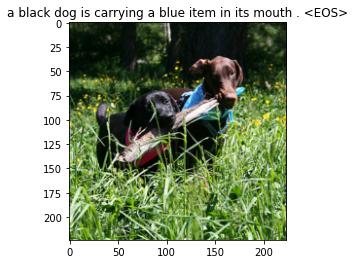

  8%|▊         | 99/1265 [00:45<09:06,  2.13it/s]

Epoch: 24 loss: 1.77534


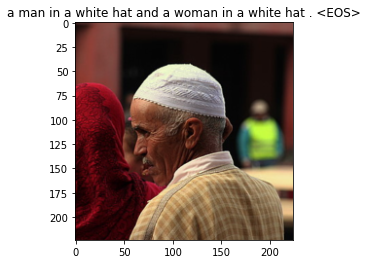

 16%|█▌        | 199/1265 [01:31<08:33,  2.08it/s]

Epoch: 24 loss: 1.74435


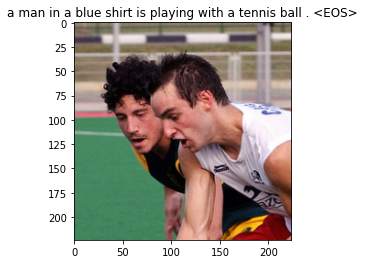

 24%|██▎       | 299/1265 [02:18<07:34,  2.13it/s]

Epoch: 24 loss: 1.76123


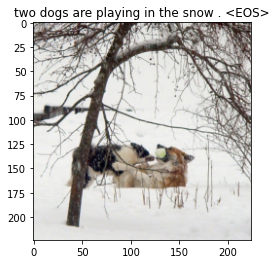

 32%|███▏      | 399/1265 [03:04<06:29,  2.22it/s]

Epoch: 24 loss: 1.84325


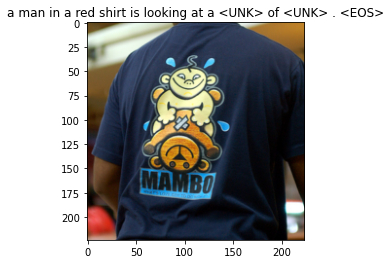

 39%|███▉      | 499/1265 [03:50<05:30,  2.32it/s]

Epoch: 24 loss: 1.72638


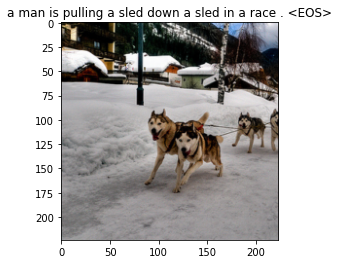

 47%|████▋     | 599/1265 [04:36<04:44,  2.34it/s]

Epoch: 24 loss: 1.93776


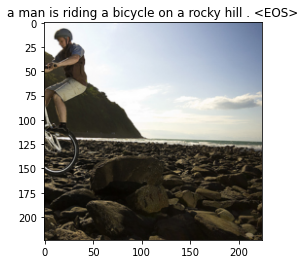

 55%|█████▌    | 699/1265 [05:22<04:08,  2.28it/s]

Epoch: 24 loss: 1.74841


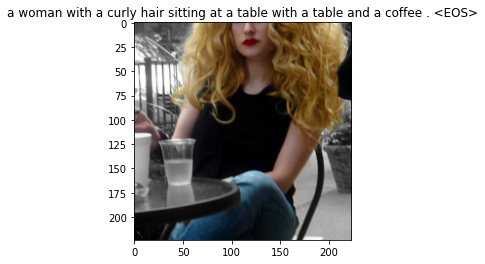

 63%|██████▎   | 799/1265 [06:09<03:36,  2.15it/s]

Epoch: 24 loss: 1.82404


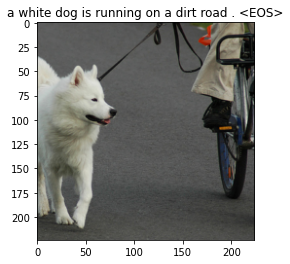

 71%|███████   | 899/1265 [06:55<02:35,  2.35it/s]

Epoch: 24 loss: 1.79027


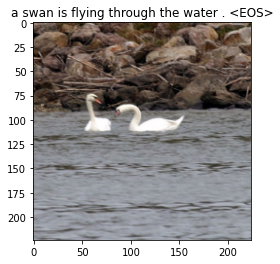

 79%|███████▉  | 999/1265 [07:41<02:12,  2.01it/s]

Epoch: 24 loss: 1.89840


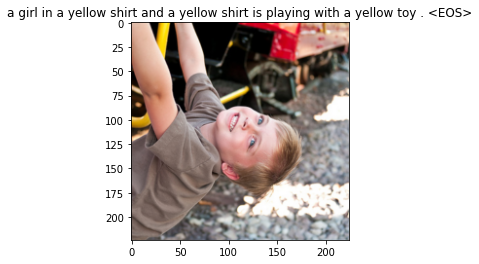

 87%|████████▋ | 1099/1265 [08:28<01:12,  2.28it/s]

Epoch: 24 loss: 1.81777


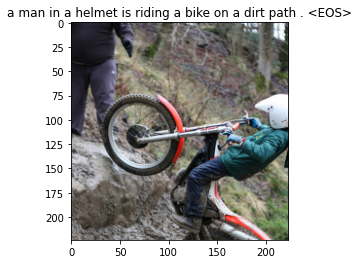

 95%|█████████▍| 1199/1265 [09:14<00:29,  2.27it/s]

Epoch: 24 loss: 1.74540


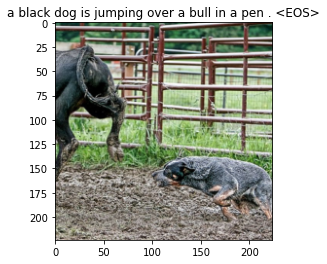

  8%|▊         | 99/1265 [00:45<09:23,  2.07it/s]

Epoch: 25 loss: 1.62933


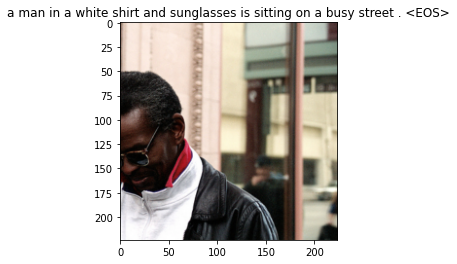

 16%|█▌        | 199/1265 [01:31<07:47,  2.28it/s]

Epoch: 25 loss: 1.78893


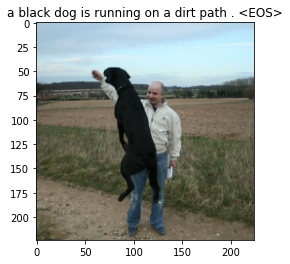

 24%|██▎       | 299/1265 [02:17<07:05,  2.27it/s]

Epoch: 25 loss: 1.76591


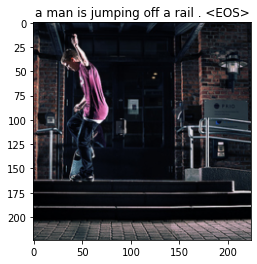

 32%|███▏      | 399/1265 [03:04<07:02,  2.05it/s]

Epoch: 25 loss: 1.89158


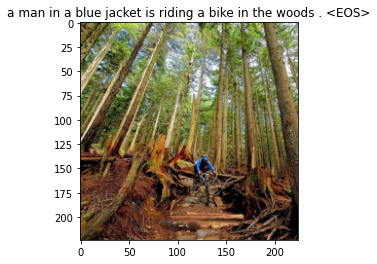

 39%|███▉      | 499/1265 [03:50<06:16,  2.04it/s]

Epoch: 25 loss: 1.85836


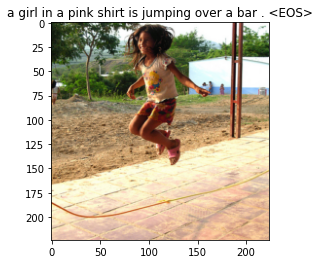

 47%|████▋     | 599/1265 [04:36<04:50,  2.29it/s]

Epoch: 25 loss: 1.79793


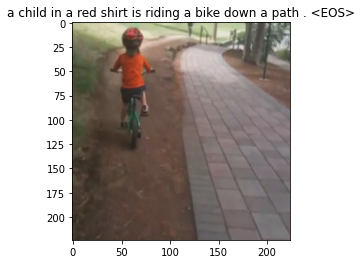

 55%|█████▌    | 699/1265 [05:23<04:25,  2.13it/s]

Epoch: 25 loss: 1.79090


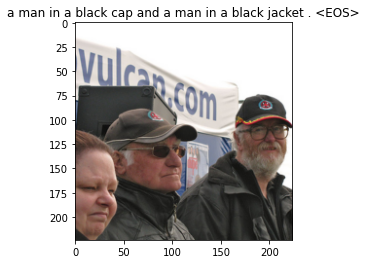

 63%|██████▎   | 799/1265 [06:09<03:24,  2.27it/s]

Epoch: 25 loss: 1.66495


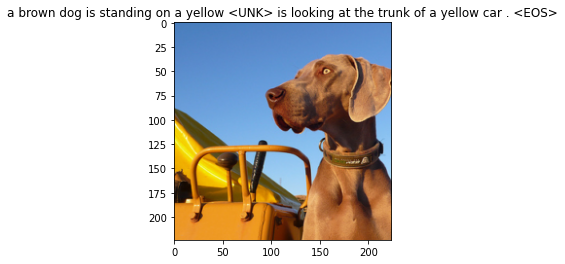

 71%|███████   | 899/1265 [06:55<02:43,  2.24it/s]

Epoch: 25 loss: 1.84219


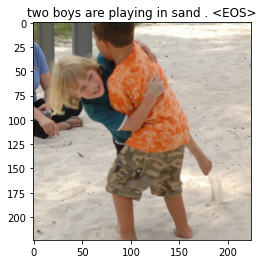

 79%|███████▉  | 999/1265 [07:42<01:57,  2.27it/s]

Epoch: 25 loss: 1.87392


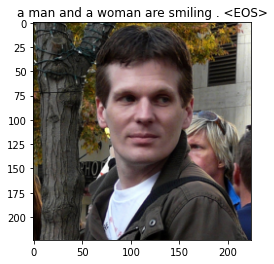

 87%|████████▋ | 1099/1265 [08:28<01:13,  2.26it/s]

Epoch: 25 loss: 1.76975


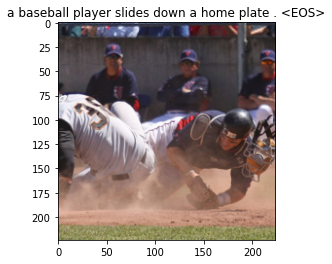

 95%|█████████▍| 1199/1265 [09:14<00:28,  2.31it/s]

Epoch: 25 loss: 1.89567


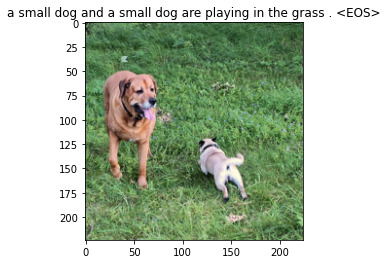

100%|██████████| 1265/1265 [09:45<00:00,  2.16it/s]


In [4]:
num_epochs = 10
print_every = 100

for epoch in range(1,num_epochs+1):   
    for idx, (image, captions) in enumerate(iter(tqdm(data_loader))):
        image,captions = image.to(device), captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs,attentions = model(image, captions)

        # Calculate the batch loss.
        targets = captions[:,1:]
        loss = criterion(outputs.view(-1, vocab_size), targets.reshape(-1))
        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()
            
            #generate the caption
            model.eval()
            with torch.no_grad():
                dataiter = iter(data_loader)
                img,_ = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)
                
            model.train()
            
    if (idx+1)%print_every == 0:
        print("Epoch: {} loss: {:.5f}".format(epoch,loss.item()))
        
    #save the latest model
    save_model(model,epoch)

In [13]:
#generate caption
def get_caps_from(features_tensors):
    #generate the caption
    model.eval()
    with torch.no_grad():
        features = model.encoder(features_tensors.to(device))
        caps,alphas = model.decoder.generate_caption(features,vocab=dataset.vocab)
        caption = ' '.join(caps)
        show_image(features_tensors[0],title=caption)
    
    return caps,alphas

#Show attention
def plot_attention(img, result, attention_plot):
    #untransform
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    temp_image = img

    fig = plt.figure(figsize=(15, 15))

    len_result = len(result)
    for l in range(len_result):
        temp_att = attention_plot[l].reshape(7,7)
        
        ax = fig.add_subplot(len_result//2,len_result//2, l+1)
        ax.set_title(result[l])
        img = ax.imshow(temp_image)
        ax.imshow(temp_att, cmap='gray', alpha=0.7, extent=img.get_extent())
        

    plt.tight_layout()
    plt.show()

In [18]:
saved_state = torch.load('attention_model_state.pth')
model.load_state_dict(saved_state['state_dict'])
model.eval();

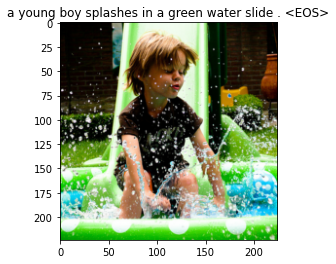

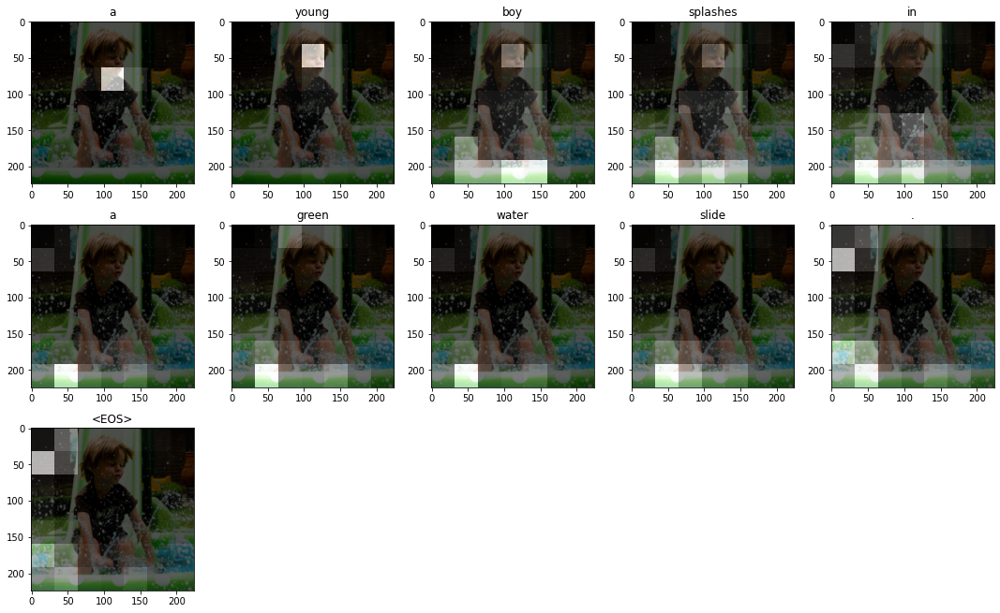

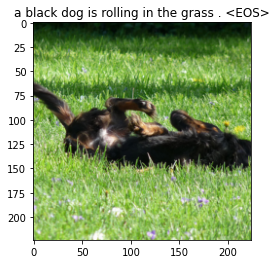

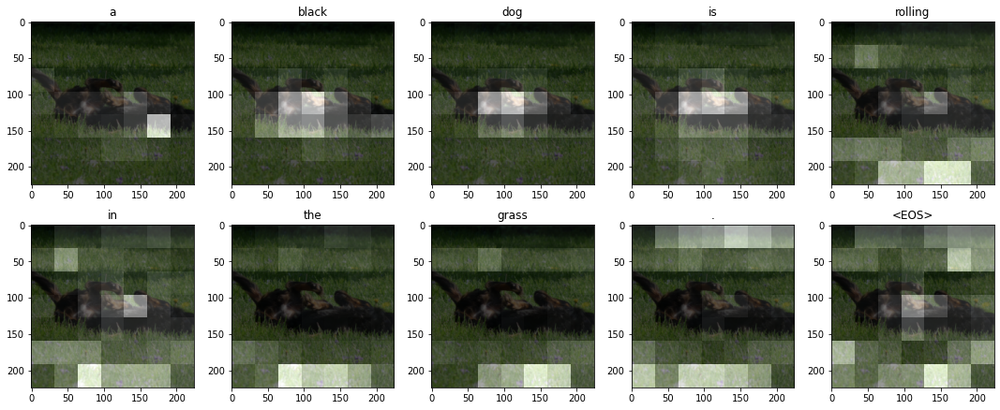

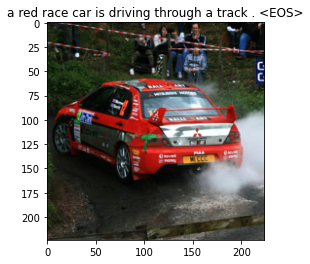

...

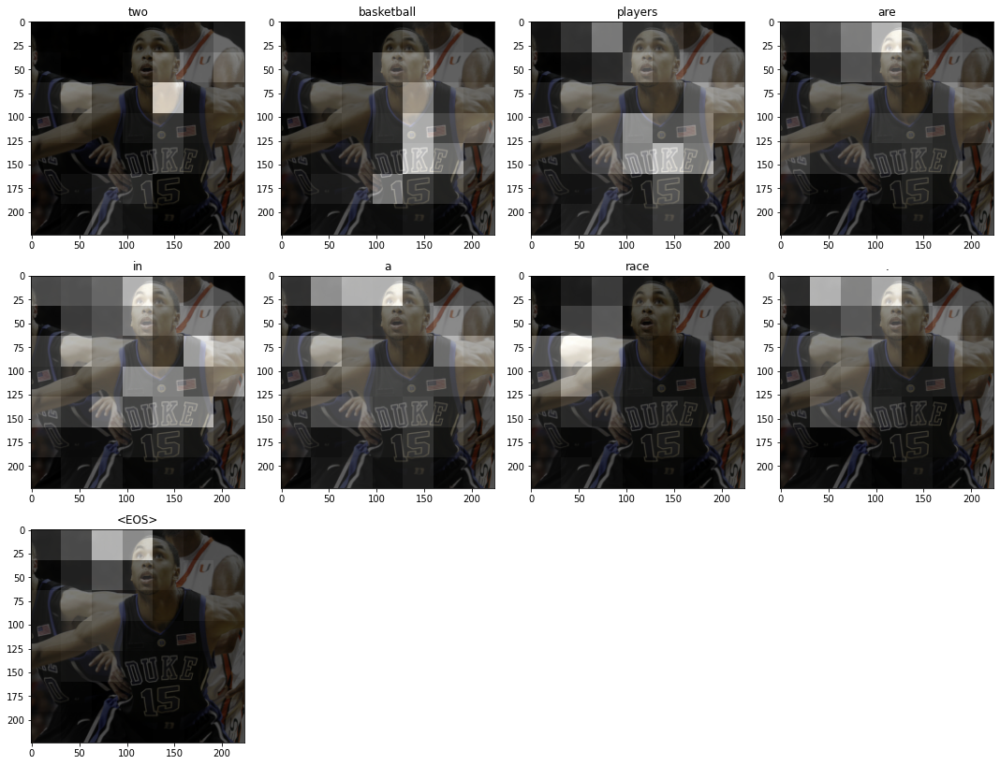

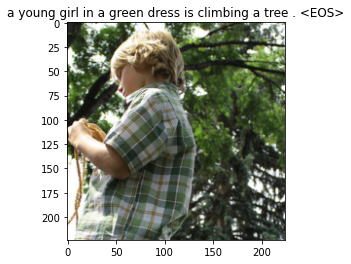

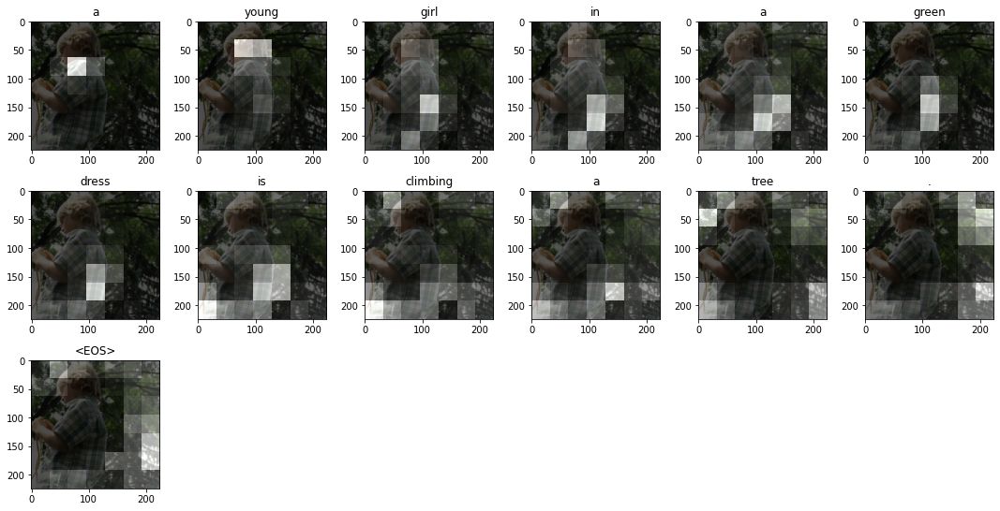

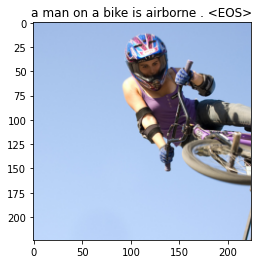

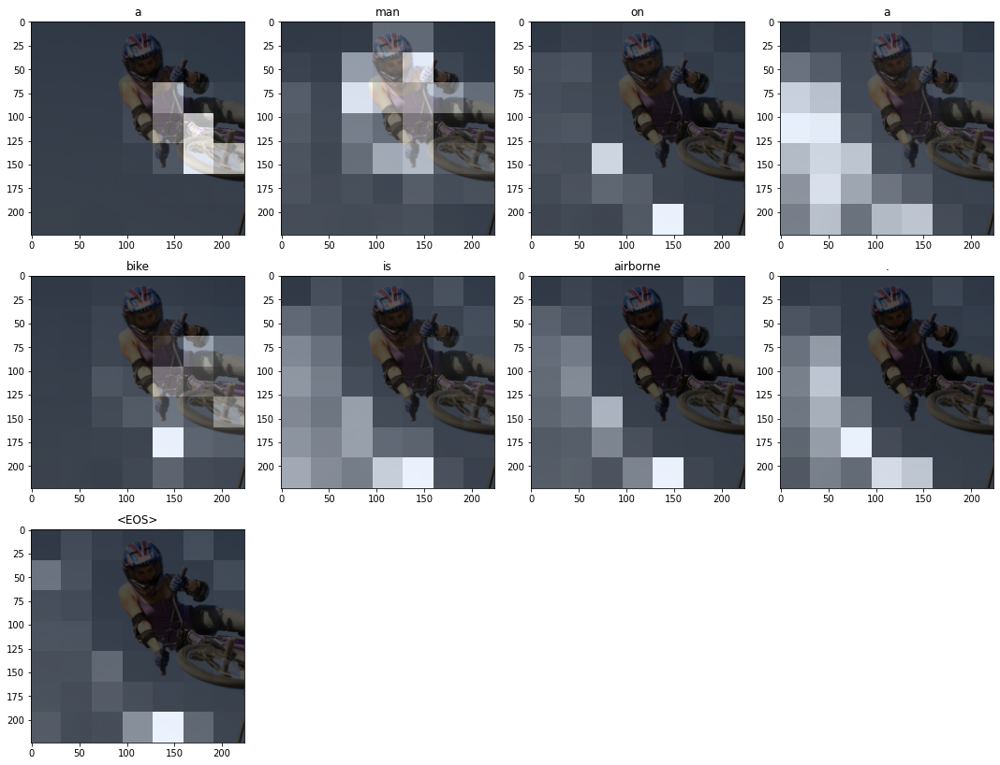

In [17]:
for i in range(10):
    #show any 1
    dataiter = iter(data_loader)
    images,_ = next(dataiter)

    img = images[0].detach().clone()
    img1 = images[0].detach().clone()
    caps,alphas = get_caps_from(img.unsqueeze(0))

    plot_attention(img1, caps, alphas)